(longitudinal_models)=
# Longitudinal Models of Change

:::{post} April, 2023
:tags: hierarchical, longitudinal, time series
:category: advanced, reference
:author: Nathaniel Forde
:::

In [1]:
import arviz as az
import bambi as bmb
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pymc as pm
import statsmodels.api as sm
import xarray as xr

from pymc.sampling_jax import sample_numpyro_nuts

lowess = sm.nonparametric.lowess

/Users/nathanielforde/mambaforge/envs/pymc_examples_new/lib/python3.9/site-packages/pymc/sampling/jax.py:39: UserWarning: This module is experimental.
  warnings.warn("This module is experimental.")


In [2]:
%config InlineBackend.figure_format = 'retina'  # high resolution figures
az.style.use("arviz-darkgrid")
rng = np.random.default_rng(42)

The study of change involves simultaneously analysing the individual trajectories of change and abstracting over the set of individuals studied to extract broader insight about the nature of the change in question. As such it's easy to lose sight of the forest for the focus on the trees. In this example we'll demonstrate some of the subtleties of using hierarchical bayesian models to study the change within a population of individuals  - moving from the *within individual* view to the *between/cross individuals* perspective. 

We'll follow the discussion and iterative approach to model building outlined in Singer and Willett's *Applied Longitudinal Data Analysis*. For more details {cite:t}`singer2003`). We'll differ from their presentation in that while they focus on maximum likelihood methods for fitting their data we'll use PyMC and Bayesian methods. In this approach we're following Solomon Kurz's work with brms in {cite:t}`kurzAppliedLongitudinalDataAnalysis2021`. We strongly recommend both books for more detailed presentation of the issues discussed here. 

### Structure of the Presentation

- Analysis of the Change over time in Alcohol consumption among teens
- Interlude: Alternative Model Specification with Bambi
- Analysis of the Change over time in Externalising Behaviours among teens
- Conclusion

## Exploratory Data Analysis: The Chaos of Individual Differences

For any longitudinal analysis we need three components: (1) multiple waves of data collection (2) a suitable definition of time and (3) an outcome of interest. Combining these we can assess how the individual changes over time with respect that outcome. In this first series of models we will look at how adolescent alcohol usage varies between children from the age of 14 onwards with data collected annually over three years.

In [3]:
try:
    df = pd.read_csv("../data/alcohol1_pp.csv")
except FileNotFoundError:
    df = pd.read_csv(pm.get_data("alcohol1_pp.csv"))

df["peer_hi_lo"] = np.where(df["peer"] > df["peer"].mean(), 1, 0)
df

,id,age,coa,male,age_14,alcuse,peer,cpeer,ccoa,peer_hi_lo
0,1,14,1,0,0,1.732051,1.264911,0.246911,0.549,1
1,1,15,1,0,1,2.000000,1.264911,0.246911,0.549,1
2,1,16,1,0,2,2.000000,1.264911,0.246911,0.549,1
3,2,14,1,1,0,0.000000,0.894427,-0.123573,0.549,0
4,2,15,1,1,1,0.000000,0.894427,-0.123573,0.549,0
...,...,...,...,...,...,...,...,...,...,...
241,81,15,0,1,1,0.000000,1.549193,0.531193,-0.451,1
242,81,16,0,1,2,0.000000,1.549193,0.531193,-0.451,1
243,82,14,0,0,0,0.000000,2.190890,1.172890,-0.451,1
244,82,15,0,0,1,1.414214,2.190890,1.172890,-0.451,1


First we'll examine the consumption patterns of a subset of the chidren to see how their reported usage exhibits a range of different trajectories. All the trajectories can be plausibly modelled as a linear phenomena. 

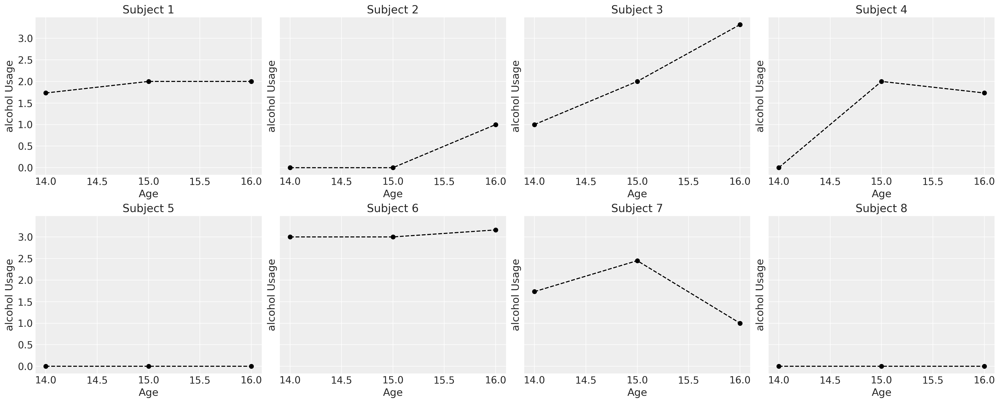

In [4]:
fig, axs = plt.subplots(2, 4, figsize=(20, 8), sharey=True)
axs = axs.flatten()
for i, ax in zip(df["id"].unique()[0:8], axs):
    temp = df[df["id"] == i].sort_values("age")
    ax.plot(temp["age"], temp["alcuse"], "--o", color="black")
    ax.set_title(f"Subject {i}")
    ax.set_ylabel("alcohol Usage")
    ax.set_xlabel("Age")

We might think that the alcohol usage patterns varies by the effects of gender, but individual trajectories are noisy. In the next series of plots we fit simple regression models over the individual data and color the trend line by whether or not the slope coefficient is $\color{green}{negative}$ or $\color{red}{positive}$. This very crudely gives an impression of whether and how the consumption patterns change for individuals of each gender. 

The green and red lines represent an individual's OLS fit, but the grey dotted lines represent an individual's observed trajectory. 

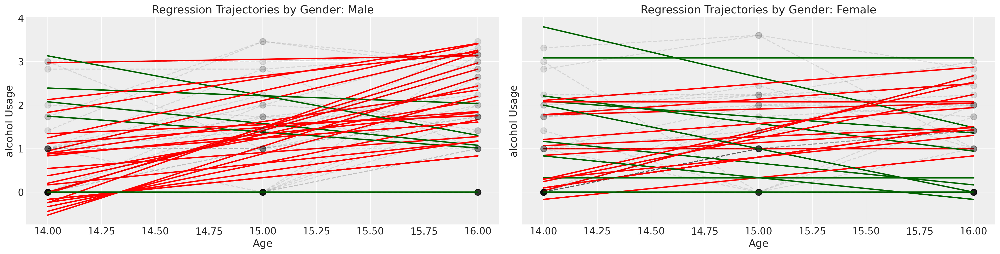

In [5]:
fig, axs = plt.subplots(1, 2, figsize=(20, 5), sharey=True)
lkup = {0: "Male", 1: "Female"}

axs = axs.flatten()
for i in df["id"].unique():
    temp = df[df["id"] == i].sort_values("age")
    params = np.polyfit(temp["age"], temp["alcuse"], 1)
    positive_slope = params[0] > 0
    if temp["male"].values[0] == 1:
        index = 0
    else:
        index = 1
    if positive_slope:
        color = "red"
    else:
        color = "darkgreen"
    y = params[0] * temp["age"] + params[1]
    axs[index].plot(temp["age"], y, "-", color=color, linewidth=2)
    axs[index].plot(
        temp["age"], temp["alcuse"], "--o", mec="black", alpha=0.1, markersize=9, color="black"
    )
    axs[index].set_title(f"Regression Trajectories by Gender: {lkup[index]}")
    axs[index].set_ylabel("alcohol Usage")
    axs[index].set_xlabel("Age")

Next we examine the same plot but stratify the children by whether or not they were a child of an alcoholic parent. 

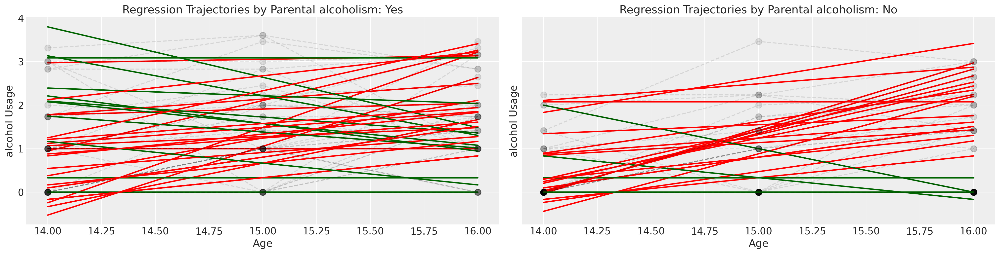

In [6]:
fig, axs = plt.subplots(1, 2, figsize=(20, 5), sharey=True)
lkup = {0: "Yes", 1: "No"}
axs = axs.flatten()
for i in df["id"].unique():
    temp = df[df["id"] == i].sort_values("age")
    params = np.polyfit(temp["age"], temp["alcuse"], 1)
    positive_slope = params[0] > 0
    if temp["coa"].values[0] == 1:
        index = 0
    else:
        index = 1
    if positive_slope:
        color = "red"
    else:
        color = "darkgreen"
    y = params[0] * temp["age"] + params[1]
    axs[index].plot(temp["age"], y, "-", color=color, linewidth=2)
    axs[index].plot(
        temp["age"], temp["alcuse"], "--o", alpha=0.1, mec="black", markersize=9, color="black"
    )
    axs[index].set_title(f"Regression Trajectories by Parental alcoholism: {lkup[index]}")
    axs[index].set_ylabel("alcohol Usage")
    axs[index].set_xlabel("Age")

We'll conclude our exploration of this data set by crudely grouping the children into whether or not their peer group reports a high score of alcohol usage. 

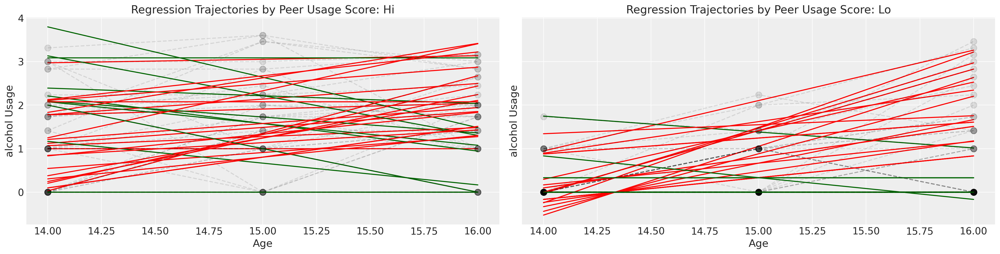

In [7]:
fig, axs = plt.subplots(1, 2, figsize=(20, 5), sharey=True)
lkup = {0: "Hi", 1: "Lo"}
axs = axs.flatten()
for i in df["id"].unique():
    temp = df[df["id"] == i].sort_values("age")
    params = np.polyfit(temp["age"], temp["alcuse"], 1)
    positive_slope = params[0] > 0
    if temp["peer_hi_lo"].values[0] == 1:
        index = 0
    else:
        index = 1
    if positive_slope:
        color = "red"
    else:
        color = "darkgreen"
    y = params[0] * temp["age"] + params[1]
    axs[index].plot(temp["age"], y, "-", color=color, label="Regression Fit")
    axs[index].plot(
        temp["age"],
        temp["alcuse"],
        "--o",
        mec="black",
        alpha=0.1,
        markersize=9,
        color="black",
        label="Observed",
    )
    axs[index].set_title(f"Regression Trajectories by Peer Usage Score: {lkup[index]}")
    axs[index].set_ylabel("alcohol Usage")
    axs[index].set_xlabel("Age")

The overall impression of this exploratory exercise is to cement the idea of complexity. There are many individual trajectories and unique journeys through time, but if we want to say something general about the phenomena of interest: parental alcoholism on child's alcohol usage we need to do more than give up in the face of complexity. 

# Modelling Change over Time.

We begin with a simple unconditional model where we model only the individual's contribution to the final outcome. In other words this model is marked by the distinction that it contains no predictors. It serves to partition the sources of variation in the outcome, ascribing more or less aberrant behaviour to each individual in the degree that they move away from the grand mean.

## The Unconditional Mean Model



Sampling: [global_intercept, global_sigma, outcome, subject_intercept, subject_intercept_sigma]
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [subject_intercept_sigma, subject_intercept, global_sigma, global_intercept]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 3 seconds.
Sampling: [outcome]


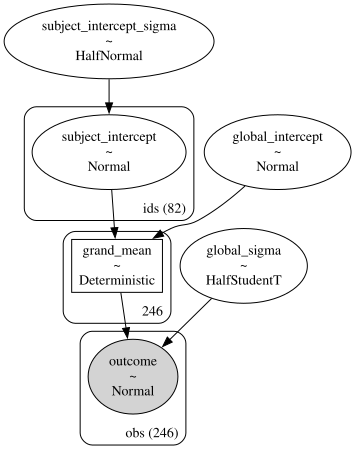

In [8]:
id_indx, unique_ids = pd.factorize(df["id"])
coords = {"ids": unique_ids, "obs": range(len(df["alcuse"]))}
with pm.Model(coords=coords) as model:
    subject_intercept_sigma = pm.HalfNormal("subject_intercept_sigma", 2)
    subject_intercept = pm.Normal("subject_intercept", 0, subject_intercept_sigma, dims="ids")
    global_sigma = pm.HalfStudentT("global_sigma", 1, 3)
    global_intercept = pm.Normal("global_intercept", 0, 1)
    grand_mean = pm.Deterministic("grand_mean", global_intercept + subject_intercept[id_indx])
    outcome = pm.Normal("outcome", grand_mean, global_sigma, observed=df["alcuse"], dims="obs")
    idata_m0 = pm.sample_prior_predictive()
    idata_m0.extend(
        pm.sample(random_seed=100, target_accept=0.95, idata_kwargs={"log_likelihood": True})
    )
    idata_m0.extend(pm.sample_posterior_predictive(idata_m0))

pm.model_to_graphviz(model)

In [9]:
az.summary(idata_m0, var_names=["subject_intercept_sigma", "global_intercept", "global_sigma"])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
subject_intercept_sigma,0.766,0.083,0.611,0.917,0.001,0.001,2984.0,2542.0,1.0
global_intercept,0.914,0.099,0.706,1.082,0.003,0.002,1262.0,1739.0,1.0
global_sigma,0.757,0.043,0.674,0.835,0.001,0.001,3331.0,2989.0,1.0


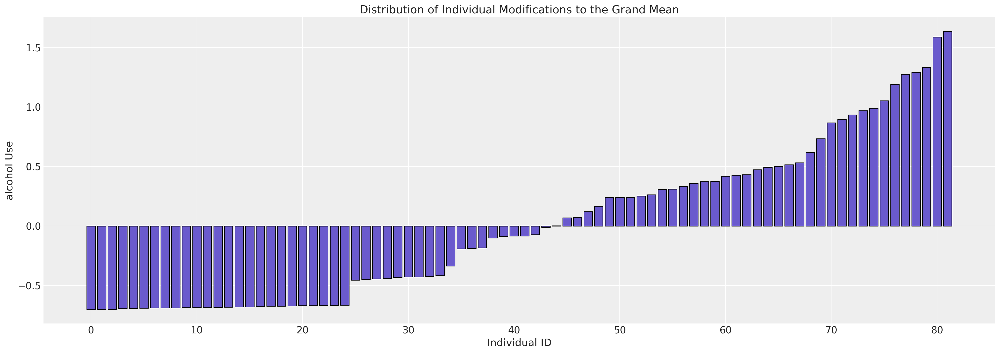

In [10]:
fig, ax = plt.subplots(figsize=(20, 7))
expected_individual_mean = idata_m0.posterior["subject_intercept"].mean(axis=1).values[0]

ax.bar(
    range(len(expected_individual_mean)),
    np.sort(expected_individual_mean),
    color="slateblue",
    ec="black",
)
ax.set_xlabel("Individual ID")
ax.set_ylabel("alcohol Use")
ax.set_title("Distribution of Individual Modifications to the Grand Mean");

We see here the variation in the implied modification of the grand mean by each individual under the study.

## Unconditional Growth Model                     

Next we will more explictly model the individual contribution to the slope of a regression model where time is the key predictor. The structure of this model is worth pausing to consider. There are various instantiations of this kind of hierarchical model across different domains and disciplines. Economics, political science, psychometrics and ecology all have their own slightly varied vocabulary for naming the parts of the model: fixed effects, random effects, within-estimators, between estimators...etc, the list goes and the discourse is cursed. The terms are ambiguous and used divergingly. Wilett and Singer refer to the Level 1 and Level 2 sub-models, but the precise terminology is not important. 

The important thing about these models is the *hierarchy*. There is a global phenomena and a subject specific instantiation of the phenomena. The model allows us to compose the global model with the individual contributions from each subject. This helps the model account for unobserved heterogeneity at the subject level.Resulting in varying slopes and intercepts for each subject where allowed by the model specification. It can't solve all forms of bias but it does help account for this source of skew in the model predictions.

$$ \begin{aligned} 
    & alcohol \sim Normal(\color{purple}{\mu, \sigma})  \\
    & \color{purple}{\mu} = \color{red}{\alpha} + \color{green}{\beta} \cdot age \\
    & \color{red}{\alpha} = \sum_{j=0}^{N} \alpha_{1} + \alpha_{2, j} \ \ \ \ \forall j \in Subjects  \\ 
    & \color{green}{\beta} = \sum_{j=0}^{N} \beta_{1} + \beta_{2, j}  \ \ \ \ \forall j \in Subjects  \\
    & \color{purple}{\sigma} = HalfStudentT(?, ?) \\
    & \alpha_{i, j} \sim Normal(?, ?) \\
    & \beta_{i, j} \sim Normal(?, ?) 
\end{aligned} $$


Fitting the model then informs us about how each individual modifies the global model, but also lets us learn global parameters. In particular we allow for a subject specific modification of the coefficient on the variable representing time. A broadly similar pattern of combination holds for all the hierarchical models we outline in the following series of models. In the Bayesian setting we're trying to learn the parameters that best fit the data. Implementing the model in PyMC is as follows:

Sampling: [global_age_beta, global_intercept, global_sigma, outcome, subject_age_beta, subject_age_sigma, subject_intercept, subject_intercept_sigma]
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [global_intercept, global_sigma, global_age_beta, subject_intercept_sigma, subject_age_sigma, subject_intercept, subject_age_beta]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 7 seconds.
Sampling: [outcome]


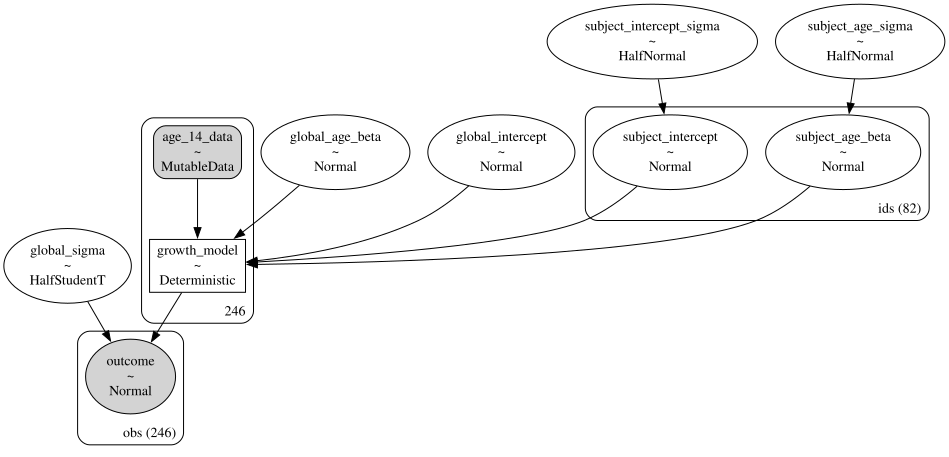

In [11]:
id_indx, unique_ids = pd.factorize(df["id"])
coords = {"ids": unique_ids, "obs": range(len(df["alcuse"]))}
with pm.Model(coords=coords) as model:
    age_14 = pm.MutableData("age_14_data", df["age_14"].values)

    ## Level 1
    global_intercept = pm.Normal("global_intercept", 0, 1)
    global_sigma = pm.HalfStudentT("global_sigma", 1, 3)
    global_age_beta = pm.Normal("global_age_beta", 0, 1)

    subject_intercept_sigma = pm.HalfNormal("subject_intercept_sigma", 5)
    subject_age_sigma = pm.HalfNormal("subject_age_sigma", 5)

    ## Level 2
    subject_intercept = pm.Normal("subject_intercept", 0, subject_intercept_sigma, dims="ids")
    subject_age_beta = pm.Normal("subject_age_beta", 0, subject_age_sigma, dims="ids")

    growth_model = pm.Deterministic(
        "growth_model",
        (global_intercept + subject_intercept[id_indx])
        + (global_age_beta + subject_age_beta[id_indx]) * age_14,
    )
    outcome = pm.Normal(
        "outcome", growth_model, global_sigma, observed=df["alcuse"].values, dims="obs"
    )
    idata_m1 = pm.sample_prior_predictive()
    idata_m1.extend(
        pm.sample(random_seed=100, target_accept=0.95, idata_kwargs={"log_likelihood": True})
    )
    idata_m1.extend(pm.sample_posterior_predictive(idata_m1))

pm.model_to_graphviz(model)

The sigma terms (variance components) are likely the most important pieces of the model to understand. The global and subject specific sigma terms represent the sources of variation that we allow in our model. The global effects can be considered "fixed" over the population while the subject specific terms "random" draws from the same population. 

In [12]:
az.summary(
    idata_m1,
    var_names=[
        "global_intercept",
        "global_sigma",
        "global_age_beta",
        "subject_intercept_sigma",
        "subject_age_sigma",
    ],
)

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
global_intercept,0.645,0.103,0.459,0.847,0.002,0.001,2535.0,2913.0,1.00
global_sigma,0.614,0.045,0.528,0.698,0.001,0.001,1090.0,1886.0,1.00
global_age_beta,0.270,0.060,0.151,0.379,0.001,0.001,4550.0,3223.0,1.00
subject_intercept_sigma,0.754,0.083,0.608,0.921,0.002,0.001,2985.0,3362.0,1.00
subject_age_sigma,0.340,0.072,0.207,0.476,0.003,0.002,605.0,363.0,1.01


We can now derive the uncertainty in the implied model by using the posterior distribution. We plot the trajectories derived across all the subjects by taking the average parameter estimate across the ids. We'll see below how we can instead focus on the within subject estimates when our focus is on the individual growth. Here our focus is on the generally implied trajectory of alcohol use in teens. 

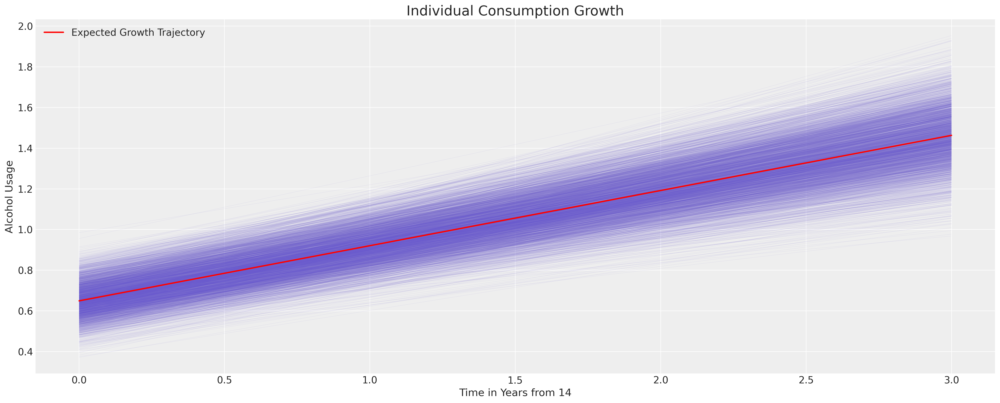

In [13]:
fig, ax = plt.subplots(figsize=(20, 8))
posterior = az.extract(idata_m1.posterior)
intercept_group_specific = posterior["subject_intercept"].mean(dim="ids")
slope_group_specific = posterior["subject_age_beta"].mean(dim="ids")
a = posterior["global_intercept"].mean() + intercept_group_specific
b = posterior["global_age_beta"].mean() + slope_group_specific
time_xi = xr.DataArray(np.arange(4))
ax.plot(time_xi, (a + b * time_xi).T, color="slateblue", alpha=0.2, linewidth=0.2)
ax.plot(
    time_xi, (a.mean() + b.mean() * time_xi), color="red", lw=2, label="Expected Growth Trajectory"
)
ax.set_ylabel("Alcohol Usage")
ax.set_xlabel("Time in Years from 14")
ax.legend()
ax.set_title("Individual Consumption Growth", fontsize=20);

## The Uncontrolled Effects of Parental Alcoholism

Next we'll add in a second predictor and the interaction of the predictor with age to modify the outcome. This extends the above model as follows: 

$$ \begin{aligned} 
    & alcohol \sim Normal(\color{purple}{\mu, \sigma})  \\
    & \color{purple}{\mu} = \color{red}{\alpha} + \color{green}{\beta_{age}} \cdot age + \color{blue}{\beta_{coa}} \cdot coa +  \color{orange}{\beta_{coa*age}}(coa*age) \\
    & \color{red}{\alpha} = \sum_{j=0}^{N} \alpha_{1} + \alpha_{2, j} \ \ \ \ \forall j \in Subjects  \\ 
    & \color{green}{\beta} = \sum_{j=0}^{N} \beta_{1} + \beta_{2, j}  \ \ \ \ \forall j \in Subjects  \\
    & \color{purple}{\sigma} = HalfStudentT(?, ?) \\
    & \alpha_{i, j} \sim Normal(?, ?) \\
    & \beta_{i, j} \sim Normal(?, ?)  \\
    & \color{blue}{\beta_{coa}} \sim Normal(?, ?) \\
    & \color{orange}{\beta_{coa*age}} \sim Normal(?,?)
\end{aligned} $$

Sampling: [global_age_beta, global_coa_age_beta, global_coa_beta, global_intercept, global_sigma, outcome, subject_age_beta, subject_age_sigma, subject_intercept, subject_intercept_sigma]
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [global_intercept, global_sigma, global_age_beta, global_coa_beta, global_coa_age_beta, subject_intercept_sigma, subject_age_sigma, subject_intercept, subject_age_beta]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 9 seconds.
Sampling: [outcome]


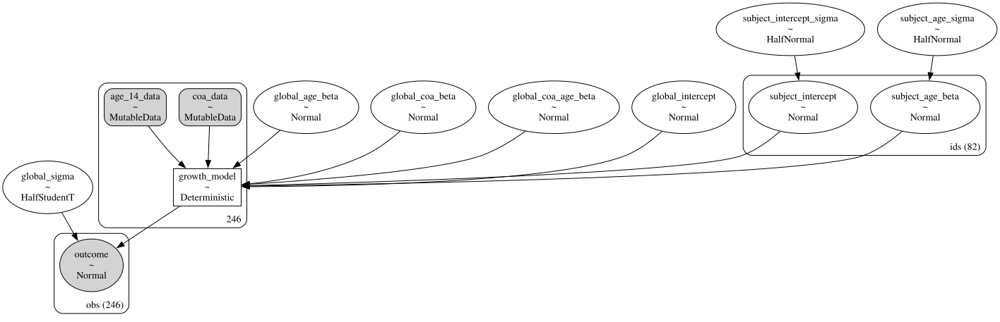

In [14]:
id_indx, unique_ids = pd.factorize(df["id"])
coords = {"ids": unique_ids, "obs": range(len(df["alcuse"]))}
with pm.Model(coords=coords) as model:
    age_14 = pm.MutableData("age_14_data", df["age_14"].values)
    coa = pm.MutableData("coa_data", df["coa"].values)

    ## Level 1
    global_intercept = pm.Normal("global_intercept", 0, 1)
    global_sigma = pm.HalfStudentT("global_sigma", 1, 3)
    global_age_beta = pm.Normal("global_age_beta", 0, 1)
    global_coa_beta = pm.Normal("global_coa_beta", 0, 1)
    global_coa_age_beta = pm.Normal("global_coa_age_beta", 0, 1)

    subject_intercept_sigma = pm.HalfNormal("subject_intercept_sigma", 5)
    subject_age_sigma = pm.HalfNormal("subject_age_sigma", 5)

    ## Level 2
    subject_intercept = pm.Normal("subject_intercept", 0, subject_intercept_sigma, dims="ids")
    subject_age_beta = pm.Normal("subject_age_beta", 0, subject_age_sigma, dims="ids")

    growth_model = pm.Deterministic(
        "growth_model",
        (global_intercept + subject_intercept[id_indx])
        + global_coa_beta * coa
        + global_coa_age_beta * (coa * age_14)
        + (global_age_beta + subject_age_beta[id_indx]) * age_14,
    )
    outcome = pm.Normal(
        "outcome", growth_model, global_sigma, observed=df["alcuse"].values, dims="obs"
    )
    idata_m2 = pm.sample_prior_predictive()
    idata_m2.extend(
        pm.sample(random_seed=100, target_accept=0.95, idata_kwargs={"log_likelihood": True})
    )
    idata_m2.extend(pm.sample_posterior_predictive(idata_m2))

pm.model_to_graphviz(model)

In [15]:
az.summary(
    idata_m2,
    var_names=[
        "global_intercept",
        "global_sigma",
        "global_age_beta",
        "global_coa_age_beta",
        "subject_intercept_sigma",
        "subject_age_sigma",
    ],
    stat_focus="median",
)

,median,mad,eti_3%,eti_97%,mcse_median,ess_median,ess_tail,r_hat
global_intercept,0.325,0.086,0.092,0.560,0.003,2307.636,2442.0,1.00
global_sigma,0.610,0.031,0.532,0.705,0.001,1685.385,1561.0,1.00
global_age_beta,0.286,0.056,0.132,0.436,0.002,3451.129,3000.0,1.00
global_coa_age_beta,-0.034,0.083,-0.266,0.188,0.003,3179.173,3140.0,1.00
subject_intercept_sigma,0.667,0.054,0.527,0.833,0.002,2309.251,2560.0,1.00
subject_age_sigma,0.351,0.046,0.188,0.475,0.003,898.331,306.0,1.01


We can see here how the inclusion of the binary flag for the parental alcoholism does not significantly impact the growth trajectory of the child's consumption, but it does shift the likely location of the intercept term. 

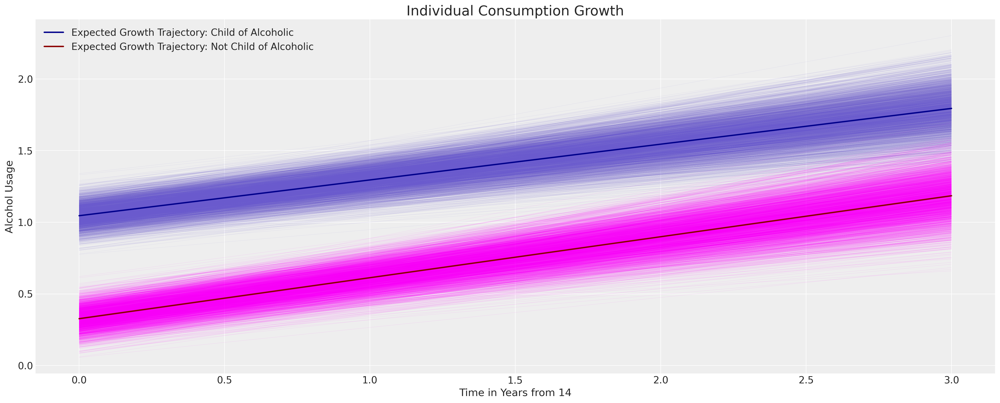

In [16]:
fig, ax = plt.subplots(figsize=(20, 8))
posterior = az.extract(idata_m2.posterior)
intercept_group_specific = posterior["subject_intercept"].mean(dim="ids")
slope_group_specific = posterior["subject_age_beta"].mean(dim="ids")
a = posterior["global_intercept"].mean() + intercept_group_specific
b = posterior["global_age_beta"].mean() + slope_group_specific
b_coa = posterior["global_coa_beta"].mean()
b_coa_age = posterior["global_coa_age_beta"].mean()

time_xi = xr.DataArray(np.arange(4))
ax.plot(
    time_xi,
    (a + b * time_xi + b_coa * 1 + b_coa_age * (time_xi * 1)).T,
    color="slateblue",
    linewidth=0.2,
    alpha=0.2,
)
ax.plot(
    time_xi,
    (a + b * time_xi + b_coa * 0 + b_coa_age * (time_xi * 0)).T,
    color="magenta",
    linewidth=0.2,
    alpha=0.2,
)
ax.plot(
    time_xi,
    (a.mean() + b.mean() * time_xi + b_coa * 1 + b_coa_age * (time_xi * 1)),
    color="darkblue",
    lw=2,
    label="Expected Growth Trajectory: Child of Alcoholic",
)
ax.plot(
    time_xi,
    (a.mean() + b.mean() * time_xi + b_coa * 0 + b_coa_age * (time_xi * 0)),
    color="darkred",
    lw=2,
    label="Expected Growth Trajectory: Not Child of Alcoholic",
)
ax.set_ylabel("Alcohol Usage")
ax.set_xlabel("Time in Years from 14")
ax.legend()
ax.set_title("Individual Consumption Growth", fontsize=20);

This is already suggestive of the manner in which hierarchical longitudinal models allow us to interrogate questions of policy and impact of causal interventions. The implications of a policy shift or a specific intervention in the implied growth trajectories can warrant dramatic investment decisions. However we'll leave these remarks as suggestive because there is a rich and contentious literature of the use of causal inference with panel data designs. The differences-in-differences literature is rife with warnings about the conditions required to meaningfully interpret causal questions. See for instance {ref}`difference_in_differences` for more discussion and references to the debate. One key point is that while the subject-level terms help account for one kind of hetereogeniety in the data, they cannot account for all sources of individual variation, especially variation which is time-dependent. 

We'll forge on for now ignoring the subtleties of causal inference, considering next how the inclusion of peer effects can alter the association implied by our model. 

## Model controlling for Peer Effects

For interpretablility and to make life simpler for our sampler we'll centre the peer data around their mean. Again this model is naturally specified using these controlling factors and their interaction terms with the focal variable of age.

$$ \begin{aligned} 
    & alcohol \sim Normal(\color{purple}{\mu, \sigma})  \\
    & \color{purple}{\mu} = \color{red}{\alpha} + \color{green}{\beta_{age}} \cdot age + \color{blue}{\beta_{coa}} \cdot coa +  \color{orange}{\beta_{coa*age}}(coa*age) + \color{pink}{\beta_{peer}}*peer + \color{lightblue}{\beta_{peer*age}}(peer*age) \\
    & \color{red}{\alpha} = \sum_{j=0}^{N} \alpha_{1} + \alpha_{2, j} \ \ \ \ \forall j \in Subjects  \\ 
    & \color{green}{\beta} = \sum_{j=0}^{N} \beta_{1} + \beta_{2, j}  \ \ \ \ \forall j \in Subjects  \\
    & \color{purple}{\sigma} = HalfStudentT(?, ?) \\
    & \alpha_{i, j} \sim Normal(?, ?) \\
    & \beta_{i, j} \sim Normal(?, ?)  \\
    & \color{blue}{\beta_{coa}} \sim Normal(?, ?) \\
    & \color{orange}{\beta_{coa*age}} \sim Normal(?,?) \\
    & \color{pink}{\beta_{peer}} \sim Normal(?, ?) \\
    & \color{lightblue}{\beta_{peer*age}} \sim Normal(?, ?)
\end{aligned} $$

Sampling: [global_age_beta, global_coa_age_beta, global_coa_beta, global_intercept, global_peer_age_beta, global_peer_beta, global_sigma, outcome, subject_age_beta, subject_age_sigma, subject_intercept, subject_intercept_sigma]
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [global_intercept, global_sigma, global_age_beta, global_coa_beta, global_peer_beta, global_coa_age_beta, global_peer_age_beta, subject_intercept_sigma, subject_age_sigma, subject_intercept, subject_age_beta]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 9 seconds.
Sampling: [outcome]


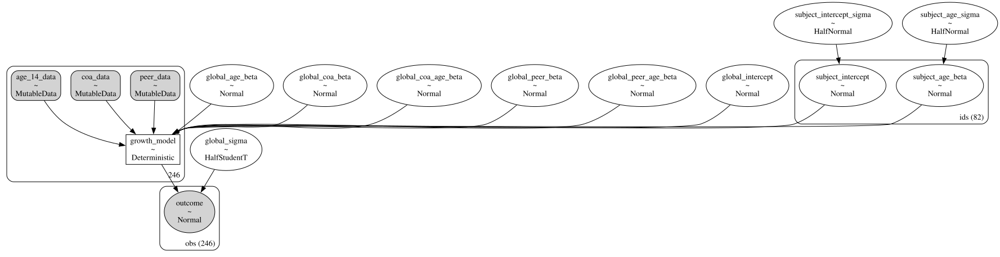

In [17]:
id_indx, unique_ids = pd.factorize(df["id"])
coords = {"ids": unique_ids, "obs": range(len(df["alcuse"]))}
with pm.Model(coords=coords) as model:
    age_14 = pm.MutableData("age_14_data", df["age_14"].values)
    coa = pm.MutableData("coa_data", df["coa"].values)
    peer = pm.MutableData("peer_data", df["cpeer"].values)

    ## Level 1
    global_intercept = pm.Normal("global_intercept", 0, 1)
    global_sigma = pm.HalfStudentT("global_sigma", 1, 3)
    global_age_beta = pm.Normal("global_age_beta", 0, 1)
    global_coa_beta = pm.Normal("global_coa_beta", 0, 1)
    global_peer_beta = pm.Normal("global_peer_beta", 0, 1)
    global_coa_age_beta = pm.Normal("global_coa_age_beta", 0, 1)
    global_peer_age_beta = pm.Normal("global_peer_age_beta", 0, 1)

    subject_intercept_sigma = pm.HalfNormal("subject_intercept_sigma", 5)
    subject_age_sigma = pm.HalfNormal("subject_age_sigma", 5)

    ## Level 2
    subject_intercept = pm.Normal("subject_intercept", 0, subject_intercept_sigma, dims="ids")
    subject_age_beta = pm.Normal("subject_age_beta", 0, subject_age_sigma, dims="ids")

    growth_model = pm.Deterministic(
        "growth_model",
        (global_intercept + subject_intercept[id_indx])
        + global_coa_beta * coa
        + global_coa_age_beta * (coa * age_14)
        + global_peer_beta * peer
        + global_peer_age_beta * (peer * age_14)
        + (global_age_beta + subject_age_beta[id_indx]) * age_14,
    )
    outcome = pm.Normal(
        "outcome", growth_model, global_sigma, observed=df["alcuse"].values, dims="obs"
    )
    idata_m3 = pm.sample_prior_predictive()
    idata_m3.extend(
        pm.sample(random_seed=100, target_accept=0.95, idata_kwargs={"log_likelihood": True})
    )
    idata_m3.extend(pm.sample_posterior_predictive(idata_m3))

pm.model_to_graphviz(model)

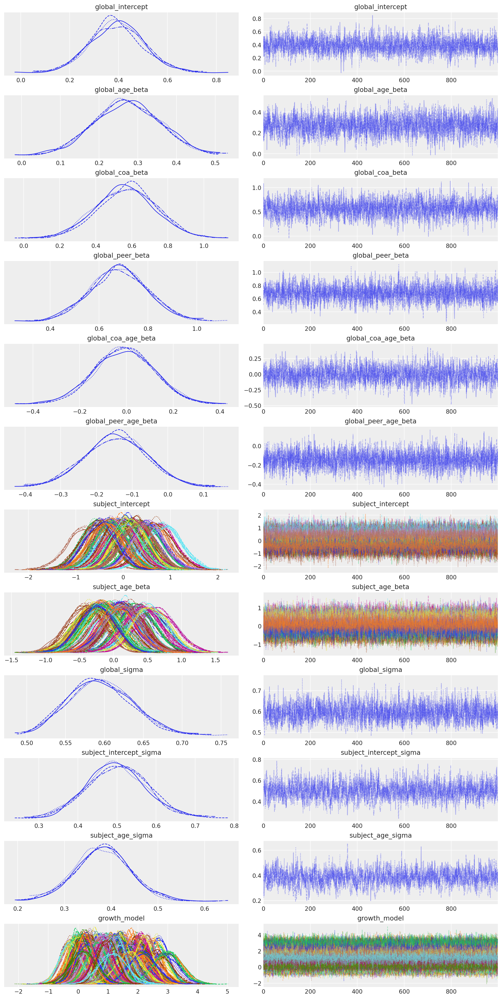

In [18]:
az.plot_trace(idata_m3);

In [19]:
az.summary(
    idata_m3,
    var_names=[
        "global_intercept",
        "global_sigma",
        "global_age_beta",
        "global_coa_age_beta",
        "global_peer_beta",
        "global_peer_age_beta",
        "subject_intercept_sigma",
        "subject_age_sigma",
    ],
)

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
global_intercept,0.393,0.109,0.191,0.606,0.002,0.002,2119.0,2645.0,1.0
global_sigma,0.595,0.041,0.518,0.669,0.001,0.001,1785.0,2501.0,1.0
global_age_beta,0.273,0.085,0.118,0.436,0.002,0.001,1791.0,2400.0,1.0
global_coa_age_beta,-0.010,0.127,-0.244,0.233,0.003,0.002,1961.0,2395.0,1.0
global_peer_beta,0.683,0.117,0.448,0.888,0.002,0.002,2747.0,2759.0,1.0
global_peer_age_beta,-0.144,0.087,-0.313,0.015,0.002,0.001,2953.0,2916.0,1.0
subject_intercept_sigma,0.500,0.077,0.347,0.635,0.002,0.002,1271.0,1729.0,1.0
subject_age_sigma,0.382,0.059,0.265,0.493,0.002,0.001,1056.0,1169.0,1.0


Next we'll plot the prototypical trajectories of change for individuals conditional on their parental and peer relationships. Notice how the peer score in the data drives the intercept of the polynomial curve up the y-axis of the chart. 

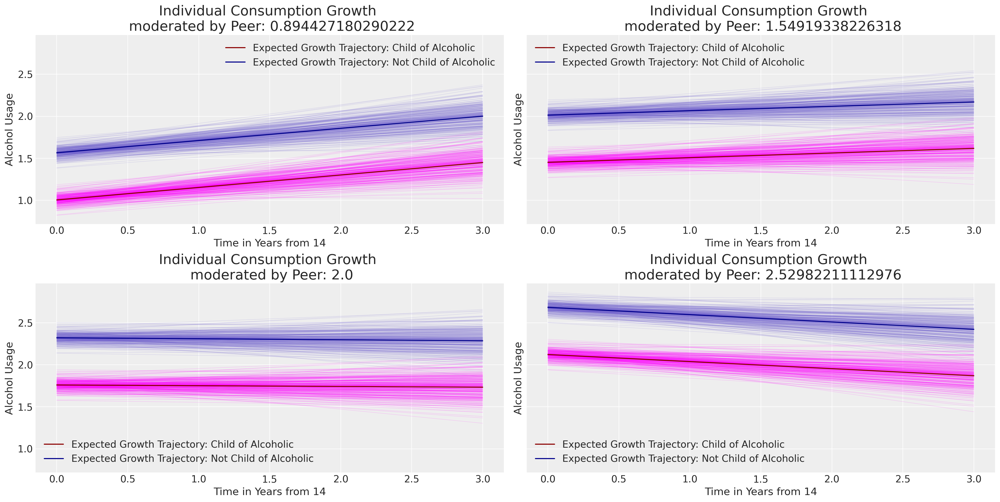

In [20]:
fig, axs = plt.subplots(2, 2, figsize=(20, 10), sharey=True)
axs = axs.flatten()
posterior = az.extract(idata_m3.posterior, num_samples=300)
intercept_group_specific = posterior["subject_intercept"].mean(dim="ids")
slope_group_specific = posterior["subject_age_beta"].mean(dim="ids")
a = posterior["global_intercept"].mean() + intercept_group_specific
b = posterior["global_age_beta"].mean() + slope_group_specific
b_coa = posterior["global_coa_beta"].mean()
b_coa_age = posterior["global_coa_age_beta"].mean()
b_peer = posterior["global_peer_beta"].mean()
b_peer_age = posterior["global_peer_age_beta"].mean()

time_xi = xr.DataArray(np.arange(4))
for q, i in zip([0.5, 0.75, 0.90, 0.99], [0, 1, 2, 3]):
    q_v = df["peer"].quantile(q)
    f1 = (
        a
        + b * time_xi
        + b_coa * 1
        + b_coa_age * (time_xi * 1)
        + b_peer * q_v
        + b_peer_age * (time_xi * q_v)
    ).T
    f2 = (
        a
        + b * time_xi
        + b_coa * 0
        + b_coa_age * (time_xi * 0)
        + b_peer * q_v
        + b_peer_age * (time_xi * q_v)
    ).T
    axs[i].plot(time_xi, f1, color="slateblue", alpha=0.2, linewidth=0.5)
    axs[i].plot(time_xi, f2, color="magenta", alpha=0.2, linewidth=0.5)
    axs[i].plot(
        time_xi,
        f2.mean(axis=1),
        color="darkred",
        label="Expected Growth Trajectory: Child of Alcoholic",
    )
    axs[i].plot(
        time_xi,
        f1.mean(axis=1),
        color="darkblue",
        label="Expected Growth Trajectory: Not Child of Alcoholic",
    )
    axs[i].set_ylabel("Alcohol Usage")
    axs[i].set_xlabel("Time in Years from 14")
    axs[i].legend()
    axs[i].set_title(f"Individual Consumption Growth \n moderated by Peer: {q_v}", fontsize=20);

## Comparison of Model Estimates

Finally, collating all our modelling efforts so far we can see how a number of things evident from the above plots:(i) the global slope parameter on the age term is quite stable across all three models in which it features. Similarly for the subject specific slope parameters on each of three individuals displayed. The global intercept parameters are pulled towards zero as we can offset more of the outcome effects into the influence of the parental and peer relationships. The global effect of parental alcoholism is broadly consistent across the models we fit. 

However, a note of caution - interpreting hierarchical models of this kind can be difficult and the meaning of particular parameters can be skewed depending on the nature of model and scale of which the variables are measured. In this notebook we've focused on understanding the implied contrasts in the marginal effects induced in our posterior predictive trajectories, by different input values of our data. This is typically the cleanest way to understand what your model has learned about the growth trajectories in question. 

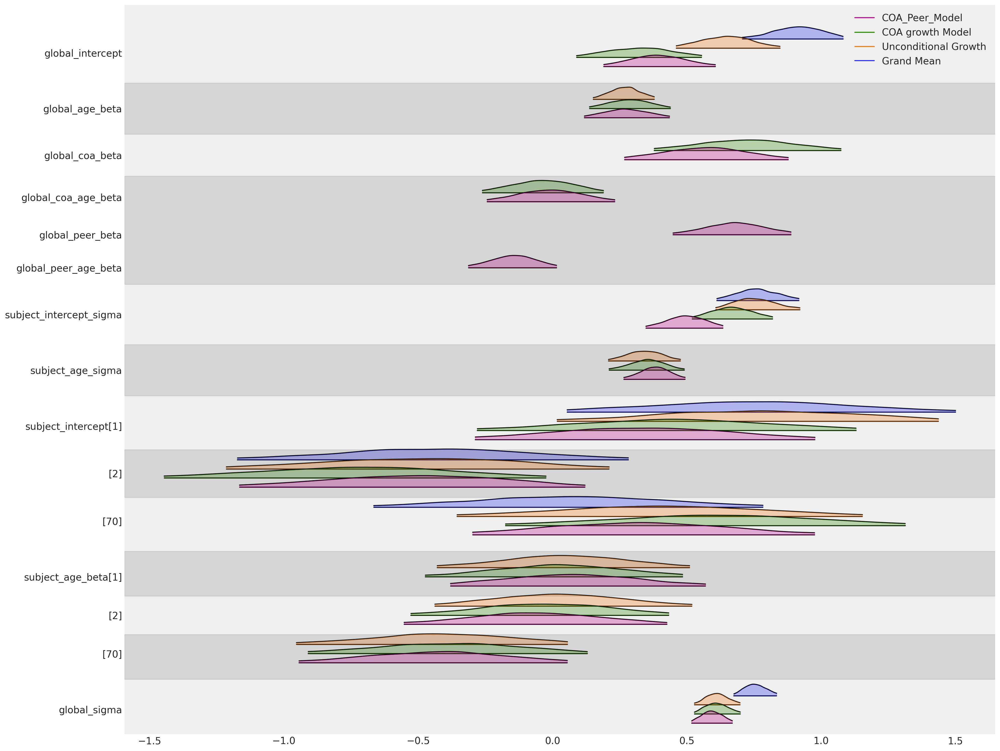

In [21]:
az.plot_forest(
    [idata_m0, idata_m1, idata_m2, idata_m3],
    model_names=["Grand Mean", "Unconditional Growth", "COA growth Model", "COA_Peer_Model"],
    var_names=[
        "global_intercept",
        "global_age_beta",
        "global_coa_beta",
        "global_coa_age_beta",
        "global_peer_beta",
        "global_peer_age_beta",
        "subject_intercept_sigma",
        "subject_age_sigma",
        "subject_intercept",
        "subject_age_beta",
        "global_sigma",
    ],
    figsize=(20, 15),
    kind="ridgeplot",
    combined=True,
    ridgeplot_alpha=0.3,
    coords={"ids": [1, 2, 70]},
);

For a numerical summary of the models Willett and Singer suggest using deviance statistics. In the Bayesian workflow we'll use the widely applicable information criteria. 

In [22]:
compare = az.compare(
    {
        "Grand Mean": idata_m0,
        "Unconditional Growth": idata_m1,
        "COA growth Model": idata_m2,
        "COA_Peer_Model": idata_m3,
    },
    "waic",
)
compare

/Users/nathanielforde/mambaforge/envs/pymc_examples_new/lib/python3.9/site-packages/arviz/stats/stats.py:1645: UserWarning: For one or more samples the posterior variance of the log predictive densities exceeds 0.4. This could be indication of WAIC starting to fail. 
See http://arxiv.org/abs/1507.04544 for details
  warnings.warn(
/Users/nathanielforde/mambaforge/envs/pymc_examples_new/lib/python3.9/site-packages/arviz/stats/stats.py:1645: UserWarning: For one or more samples the posterior variance of the log predictive densities exceeds 0.4. This could be indication of WAIC starting to fail. 
See http://arxiv.org/abs/1507.04544 for details
  warnings.warn(
/Users/nathanielforde/mambaforge/envs/pymc_examples_new/lib/python3.9/site-packages/arviz/stats/stats.py:1645: UserWarning: For one or more samples the posterior variance of the log predictive densities exceeds 0.4. This could be indication of WAIC starting to fail. 
See http://arxiv.org/abs/1507.04544 for details
  warnings.warn(
/

,rank,elpd_waic,p_waic,elpd_diff,weight,se,dse,warning,scale
COA_Peer_Model,0,-267.816066,75.161493,0.000000,1.000000e+00,11.111592,0.000000,True,log
COA growth Model,1,-276.959608,78.402055,9.143542,0.000000e+00,11.707554,3.772368,True,log
Unconditional Growth,2,-278.403556,79.522380,10.587490,0.000000e+00,12.005487,4.426693,True,log
Grand Mean,3,-312.121615,54.929336,44.305549,1.172396e-12,12.113236,8.341008,True,log


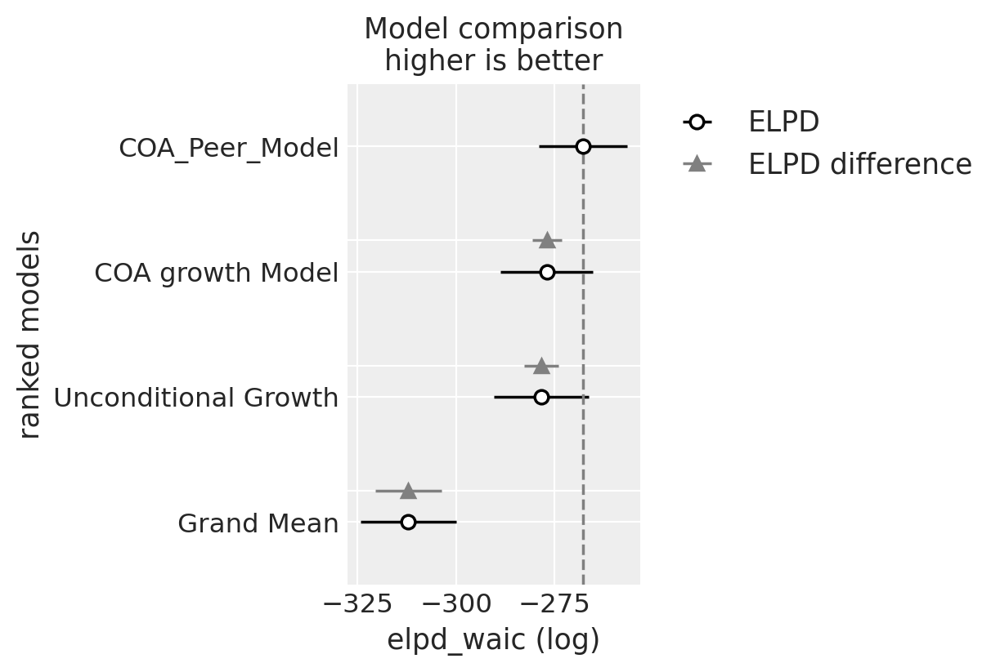

In [23]:
az.plot_compare(compare);

Willett and Singer have a detailed discussion about how to analyse the differences between the models and assess the different sources of variation to derive a number of summary statistics about the relationships between the predictors and outcomes. We highly recommend it as a deep-dive for the interested reader. 

# Interlude: Hierarchical Models with Bambi

While we're fitting these models directly within PyMC there is an alternative bayesian multi-level modelling package, Bambi which is built on top of the PyMC framework. Bambi is optimised in a number of ways for fitting hierarchical Bayesian models including the option for specifying the model structure using formulas. We'll demonstrate briefly how to fit the last model using this syntax. 

The formula specification uses `1` to denote an intercept term and a conditional `|` operator to denote a subject level parameter combined with the global parameter of the same type in the manner specified above. We will add subject specific modifications of the intercept term and beta coefficient on the focal variable of age as in the models above. We do so using the syntax `(1 + age_14 | id)` in the formula syntax for Bambi.

In [24]:
formula = "alcuse ~ 1 + age_14 + coa + cpeer + age_14:coa + age_14:cpeer + (1 + age_14 | id)"
model = bmb.Model(formula, df)

# Fit the model using 1000 on each of 4 chains
idata_bambi = model.fit(draws=1000, chains=4)
model.predict(idata_bambi, kind="pps")
idata_bambi

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [alcuse_sigma, Intercept, age_14, coa, cpeer, age_14:coa, age_14:cpeer, 1|id_sigma, 1|id_offset, age_14|id_sigma, age_14|id_offset]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 6 seconds.


Inference data with groups:
	> posterior
	> posterior_predictive
	> sample_stats
	> observed_data

The model is nicely specified and details the structure of hierarchical and subject level parameters. By default the Bambi model assigns priors and uses a non-centred parameterisation. The Bambi model definition uses the language of common and group level effects as opposed to the global and subject distinction we have beeen using in this example so far. Again, the important point to stress is just the hierarchy of levels, not the names.

In [25]:
model

       Formula: alcuse ~ 1 + age_14 + coa + cpeer + age_14:coa + age_14:cpeer + (1 + age_14 | id)
        Family: gaussian
          Link: mu = identity
  Observations: 246
        Priors: 
    target = mu
        Common-level effects
            Intercept ~ Normal(mu: 0.922, sigma: 5.0974)
            age_14 ~ Normal(mu: 0.0, sigma: 3.2485)
            coa ~ Normal(mu: 0.0, sigma: 5.3302)
            cpeer ~ Normal(mu: 0.0, sigma: 3.6587)
            age_14:coa ~ Normal(mu: 0.0, sigma: 3.5816)
            age_14:cpeer ~ Normal(mu: 0.0, sigma: 2.834)
        
        Group-level effects
            1|id ~ Normal(mu: 0.0, sigma: HalfNormal(sigma: 5.0974))
            age_14|id ~ Normal(mu: 0.0, sigma: HalfNormal(sigma: 3.2485))
        
        Auxiliary parameters
            alcuse_sigma ~ HalfStudentT(nu: 4.0, sigma: 1.0609)
------
* To see a plot of the priors call the .plot_priors() method.
* To see a summary or plot of the posterior pass the object returned by .fit() to az.summary

The model graph looks somewhat different too due to the use of offsets to achieve a non-centred parameterisation. 

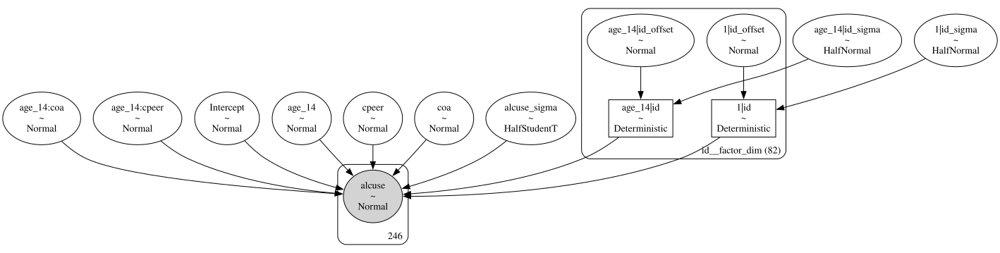

In [26]:
model.graph()

In [27]:
az.summary(
    idata_bambi,
    var_names=[
        "Intercept",
        "age_14",
        "coa",
        "cpeer",
        "age_14:coa",
        "age_14:cpeer",
        "1|id_sigma",
        "age_14|id_sigma",
        "alcuse_sigma",
    ],
)

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
Intercept,0.391,0.113,0.185,0.607,0.002,0.001,3094.0,2991.0,1.0
age_14,0.276,0.086,0.118,0.444,0.002,0.001,2490.0,2892.0,1.0
coa,0.578,0.166,0.264,0.890,0.003,0.002,2639.0,2777.0,1.0
cpeer,0.695,0.115,0.473,0.906,0.002,0.001,3057.0,2885.0,1.0
age_14:coa,-0.015,0.127,-0.247,0.227,0.003,0.002,2437.0,2548.0,1.0
age_14:cpeer,-0.149,0.088,-0.315,0.015,0.002,0.001,2889.0,2870.0,1.0
1|id_sigma,0.504,0.077,0.356,0.646,0.002,0.002,1233.0,1907.0,1.0
age_14|id_sigma,0.378,0.060,0.263,0.487,0.002,0.001,1262.0,1454.0,1.0
alcuse_sigma,0.595,0.043,0.512,0.671,0.001,0.001,1089.0,2173.0,1.0


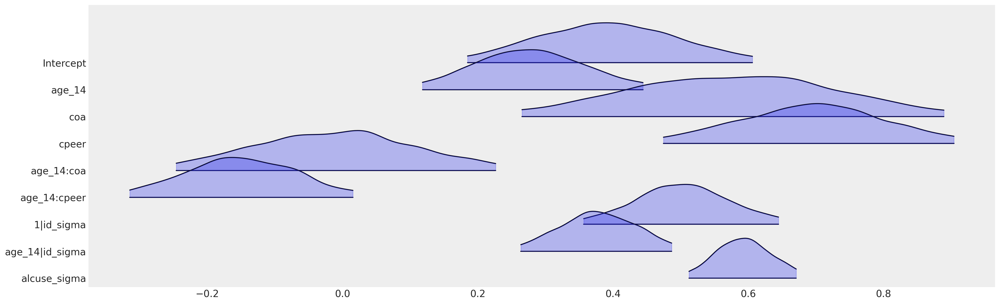

In [28]:
az.plot_forest(
    idata_bambi,
    var_names=[
        "Intercept",
        "age_14",
        "coa",
        "cpeer",
        "age_14:coa",
        "age_14:cpeer",
        "1|id_sigma",
        "age_14|id_sigma",
        "alcuse_sigma",
    ],
    figsize=(20, 6),
    kind="ridgeplot",
    combined=True,
    ridgeplot_alpha=0.3,
);

We can see here how the bambi model specification recovers the same parameterisation we derived with PyMC. In practice and in production you should use bambi when you can if you're using a Bayesian hierarchical model. It is flexible for many use-cases and you should likely only need PyMC for highly customised models, where the flexibility of the model specification cannot be accomodated with the constraints of the formula syntax.  

# Non-Linear Change Trajectories

Next we'll look at a dataset where the individual trajectories show wild swings in behaviour across the individuals. The data reports a score per child of externalizing behaviors. This can measure a variety of behaviours including but not limited to: physical aggression, verbal bullying, relational aggression, defiance, theft, and vandalism. The higher on the scale the more external behaviours demonstrated by the child. The scale is bounded at 0 and has a maximum possible score of 68. Each individual child is measured for these behaviours in each grade of school. 

In [29]:
try:
    df_external = pd.read_csv("../data/external_pp.csv")
except FileNotFoundError:
    df_external = pd.read_csv(pm.get_data("external_pp.csv"))

df_external.head()

,ID,EXTERNAL,FEMALE,TIME,GRADE
0,1,50,0,0,1
1,1,57,0,1,2
2,1,51,0,2,3
3,1,48,0,3,4
4,1,43,0,4,5


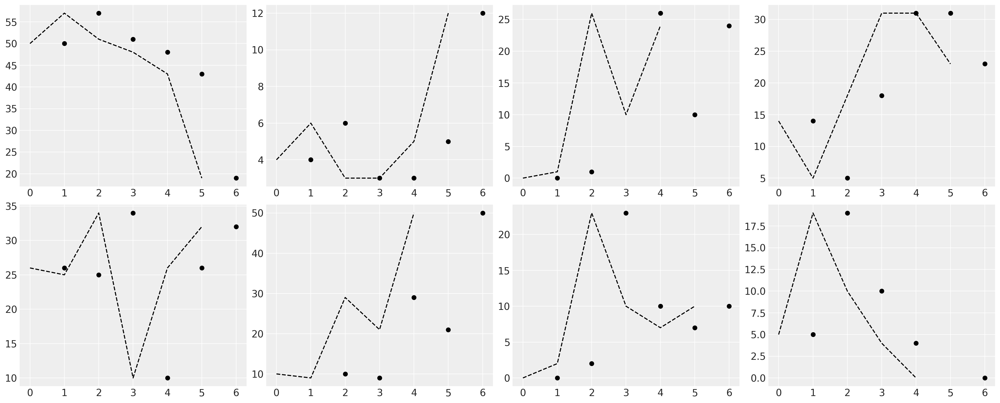

In [30]:
fig, axs = plt.subplots(2, 4, figsize=(20, 8))
axs = axs.flatten()
for ax, id in zip(axs, range(9)[1:9]):
    temp = df_external[df_external["ID"] == id]
    ax.plot(temp["GRADE"], temp["EXTERNAL"], "o", color="black")
    z = lowess(temp["EXTERNAL"], temp["GRADE"], 1 / 2)
    ax.plot(z[:, 1], "--", color="black")

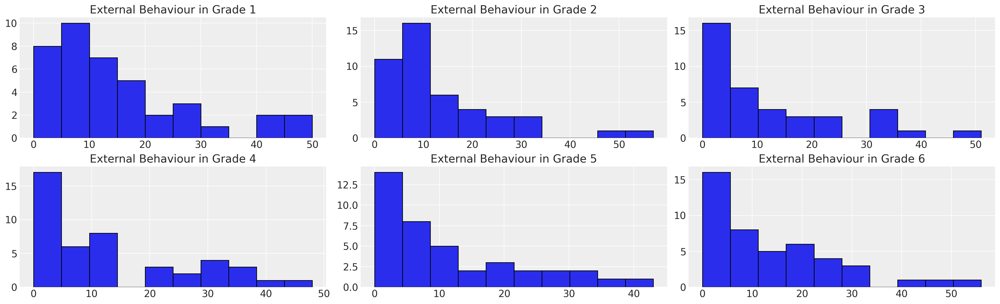

In [31]:
fig, axs = plt.subplots(2, 3, figsize=(20, 6))
axs = axs.flatten()
for ax, g in zip(axs, [1, 2, 3, 4, 5, 6]):
    temp = df_external[df_external["GRADE"] == g]
    ax.hist(temp["EXTERNAL"], bins=10, ec="black", color="C0")
    ax.set_title(f"External Behaviour in Grade {g}")

We can see that there is a strong skew in the dataset towards low `external` score. We'll diverge from Willett and Singer's presentation here and try and model this distribution as a Gumbel distribution with censoring. To do so we'll get PyMC to find a prior with on the Gumbel distribution that makes good sense. 

In [32]:
guess = pm.find_constrained_prior(
    pm.Gumbel, lower=0, upper=68, mass=0.99, init_guess={"mu": 0.60, "beta": 7}
)
print(guess)

{'mu': 8.39486550186447, 'beta': 5.495455587615175}


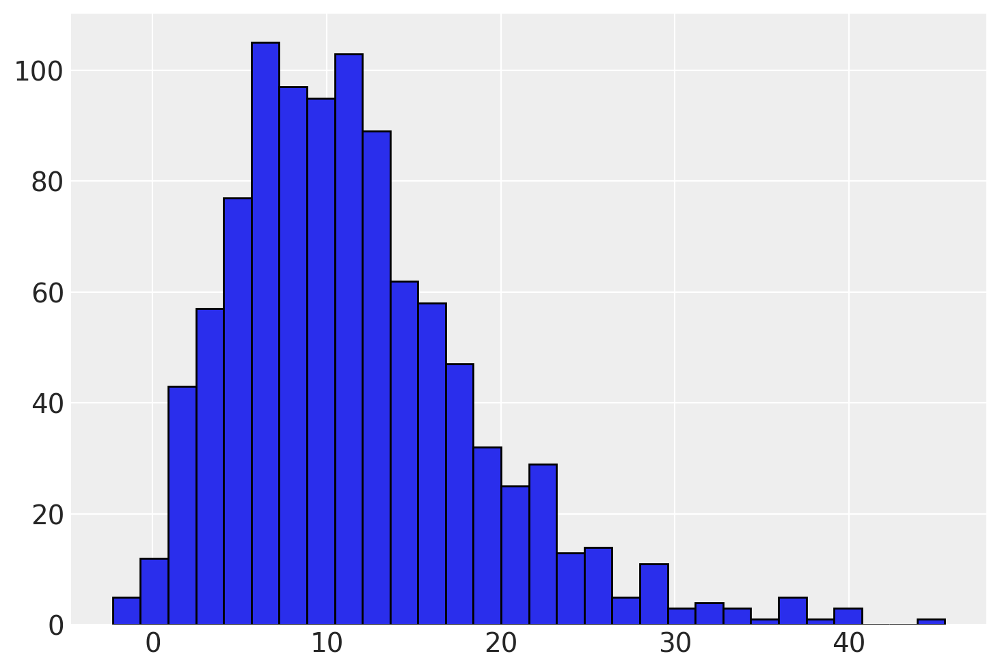

In [33]:
plt.hist(np.random.gumbel(guess["mu"], guess["beta"], 1000), bins=30, ec="black", color="C0");

## A Minimal Model

As before we'll begin with a fairly minimal model, specifying a hierarchical model where each individual modifies the grand mean. We allow for a non-normal censored likelihood term. 

Sampling: [global_intercept, global_sigma, outcome, subject_intercept, subject_intercept_sigma]
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [global_intercept, global_sigma, subject_intercept_sigma, subject_intercept]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 5 seconds.
Sampling: [outcome]


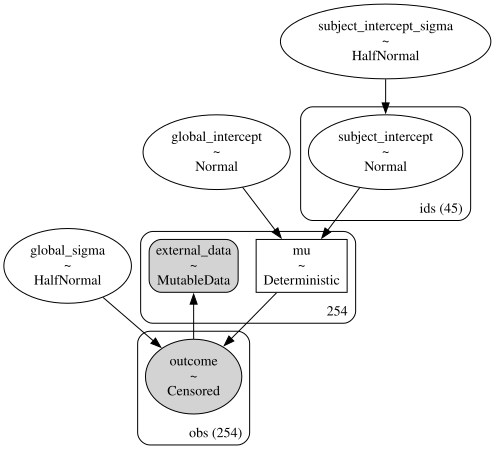

In [34]:
id_indx, unique_ids = pd.factorize(df_external["ID"])
coords = {"ids": unique_ids, "obs": range(len(df_external["EXTERNAL"]))}
with pm.Model(coords=coords) as model:
    external = pm.MutableData("external_data", df_external["EXTERNAL"].values + 1e-25)
    global_intercept = pm.Normal("global_intercept", 6, 1)
    global_sigma = pm.HalfNormal("global_sigma", 7)

    subject_intercept_sigma = pm.HalfNormal("subject_intercept_sigma", 5)
    subject_intercept = pm.Normal("subject_intercept", 0, subject_intercept_sigma, dims="ids")
    mu = pm.Deterministic("mu", global_intercept + subject_intercept[id_indx])
    outcome_latent = pm.Gumbel.dist(mu, global_sigma)
    outcome = pm.Censored(
        "outcome", outcome_latent, lower=0, upper=68, observed=external, dims="obs"
    )
    idata_m4 = pm.sample_prior_predictive()
    idata_m4.extend(
        pm.sample(random_seed=100, target_accept=0.95, idata_kwargs={"log_likelihood": True})
    )
    idata_m4.extend(pm.sample_posterior_predictive(idata_m4))

pm.model_to_graphviz(model)

In [35]:
az.summary(idata_m4, var_names=["global_intercept", "global_sigma", "subject_intercept_sigma"])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
global_intercept,7.346,0.741,5.928,8.717,0.018,0.013,1739.0,2682.0,1.0
global_sigma,6.811,0.380,6.098,7.519,0.005,0.004,4763.0,3060.0,1.0
subject_intercept_sigma,6.793,0.892,5.146,8.446,0.016,0.011,3185.0,2691.0,1.0


<Axes: xlabel='outcome / outcome'>

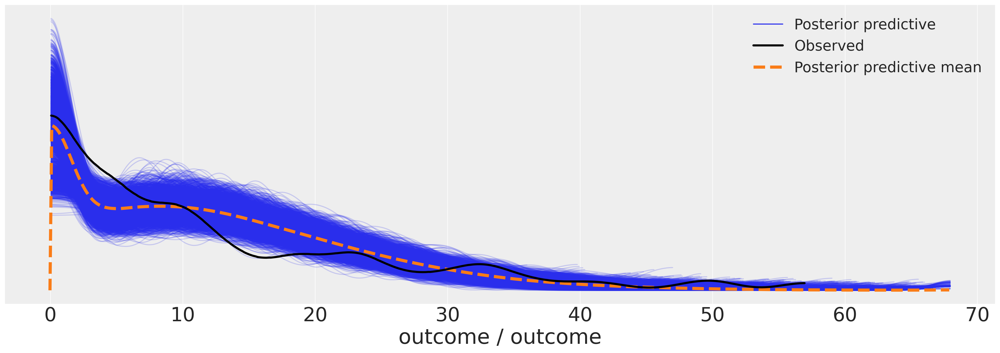

In [36]:
az.plot_ppc(idata_m4, figsize=(20, 7))

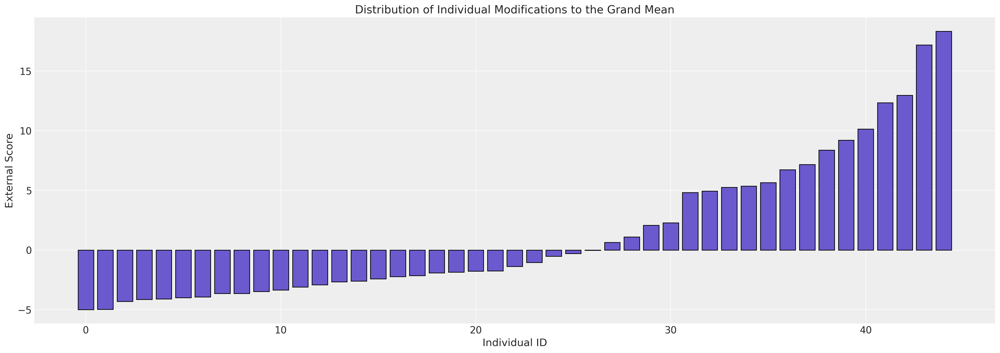

In [37]:
fig, ax = plt.subplots(figsize=(20, 7))
expected_individual_mean = idata_m4.posterior["subject_intercept"].mean(axis=1).values[0]

ax.bar(
    range(len(expected_individual_mean)),
    np.sort(expected_individual_mean),
    color="slateblue",
    ec="black",
)
ax.set_xlabel("Individual ID")
ax.set_ylabel("External Score")
ax.set_title("Distribution of Individual Modifications to the Grand Mean");

## Behaviour over time

We now model the evolution of the behaviours over time in a hierarchical fashion. We start with a simple hierarhical linear regression with a focal predictor of grade. 

Sampling: [global_beta_grade, global_intercept, global_sigma, outcome, subject_beta_grade, subject_beta_grade_sigma, subject_intercept, subject_intercept_sigma]
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [global_intercept, global_sigma, global_beta_grade, subject_intercept_sigma, subject_intercept, subject_beta_grade_sigma, subject_beta_grade]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 11 seconds.
Sampling: [outcome]


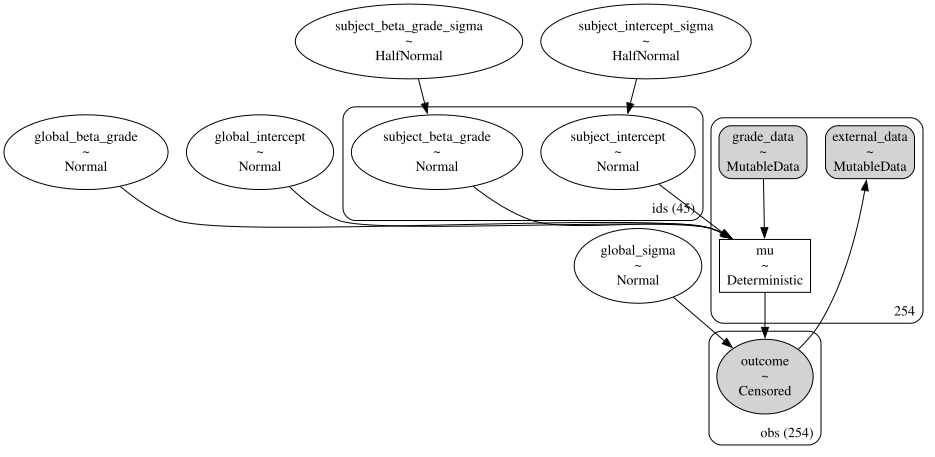

In [38]:
id_indx, unique_ids = pd.factorize(df_external["ID"])
coords = {"ids": unique_ids, "obs": range(len(df_external["EXTERNAL"]))}
with pm.Model(coords=coords) as model:
    grade = pm.MutableData("grade_data", df_external["GRADE"].values)
    external = pm.MutableData("external_data", df_external["EXTERNAL"].values + 1e-25)
    global_intercept = pm.Normal("global_intercept", 6, 1)
    global_sigma = pm.Normal("global_sigma", 7, 0.5)
    global_beta_grade = pm.Normal("global_beta_grade", 0, 1)

    subject_intercept_sigma = pm.HalfNormal("subject_intercept_sigma", 2)
    subject_intercept = pm.Normal("subject_intercept", 5, subject_intercept_sigma, dims="ids")

    subject_beta_grade_sigma = pm.HalfNormal("subject_beta_grade_sigma", 1)
    subject_beta_grade = pm.Normal("subject_beta_grade", 0, subject_beta_grade_sigma, dims="ids")
    mu = pm.Deterministic(
        "mu",
        global_intercept
        + subject_intercept[id_indx]
        + (global_beta_grade + subject_beta_grade[id_indx]) * grade,
    )
    outcome_latent = pm.Gumbel.dist(mu, global_sigma)
    outcome = pm.Censored(
        "outcome", outcome_latent, lower=0, upper=68, observed=external, dims="obs"
    )
    idata_m5 = pm.sample_prior_predictive()
    idata_m5.extend(
        pm.sample(random_seed=100, target_accept=0.95, idata_kwargs={"log_likelihood": True})
    )
    idata_m5.extend(pm.sample_posterior_predictive(idata_m5))

pm.model_to_graphviz(model)

In [39]:
az.summary(
    idata_m5,
    var_names=[
        "global_intercept",
        "global_sigma",
        "global_beta_grade",
        "subject_intercept_sigma",
        "subject_beta_grade_sigma",
    ],
)

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
global_intercept,5.380,0.835,3.706,6.823,0.014,0.010,3590.0,3021.0,1.00
global_sigma,6.889,0.317,6.287,7.474,0.005,0.004,3328.0,2253.0,1.00
global_beta_grade,-0.226,0.260,-0.709,0.250,0.004,0.004,3487.0,2895.0,1.00
subject_intercept_sigma,5.223,0.973,3.269,6.989,0.043,0.030,570.0,516.0,1.00
subject_beta_grade_sigma,0.786,0.339,0.190,1.415,0.025,0.018,169.0,107.0,1.01


We can now examine the posterior predictive plot for our model. The outcomes seem to make a reasonable fit to the data. 

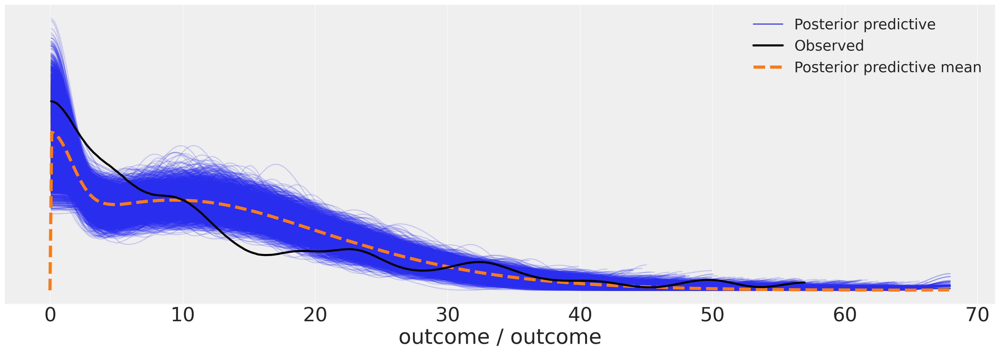

In [40]:
az.plot_ppc(idata_m5, figsize=(20, 7));

But we want to see individual model fits for each person. Here we plot the expected trajectories.

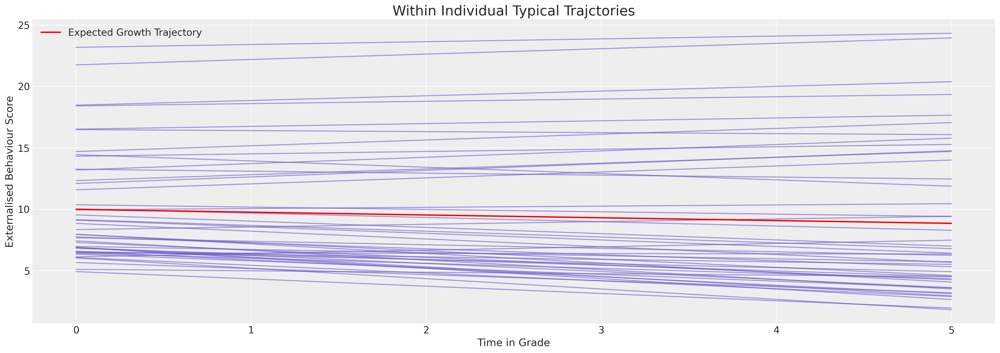

In [41]:
fig, ax = plt.subplots(figsize=(20, 7))
posterior = az.extract(idata_m5.posterior)
intercept_group_specific = posterior["subject_intercept"].mean("sample")
slope_group_specific = posterior["subject_beta_grade"].mean("sample")
a = posterior["global_intercept"].mean() + intercept_group_specific
b = posterior["global_beta_grade"].mean() + slope_group_specific

time_xi = xr.DataArray(np.arange(6))
ax.plot(time_xi, (a + b * time_xi).T, color="slateblue", alpha=0.6)
ax.plot(
    time_xi, (a.mean() + b.mean() * time_xi), color="red", lw=2, label="Expected Growth Trajectory"
)
ax.set_ylabel("Externalised Behaviour Score")
ax.set_xlabel("Time in Grade")
ax.legend()
ax.set_title("Within Individual Typical Trajctories", fontsize=20);

We can see here how the model is constrained to apply a very linear fit to the behavioural trajectories. The immediate impression is of a relatively stable behaviourial pattern for each individual. But this is artefact of the model's inability to express the curvature of the behaviourial data. Nevertheless we can see the individual variation forces the intercept terms to range between 5 and 25 on the scale. 

## Adding in Polynomial Time

To give the model more flexibility to model change over time we can add in polynomial terms. 

Sampling: [global_beta_grade, global_beta_grade2, global_intercept, global_sigma, outcome, subject_beta_grade, subject_beta_grade2, subject_beta_grade2_sigma, subject_beta_grade_sigma, subject_intercept, subject_intercept_sigma]
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [global_intercept, global_sigma, global_beta_grade, global_beta_grade2, subject_intercept_sigma, subject_intercept, subject_beta_grade_sigma, subject_beta_grade, subject_beta_grade2_sigma, subject_beta_grade2]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 54 seconds.
Sampling: [outcome]


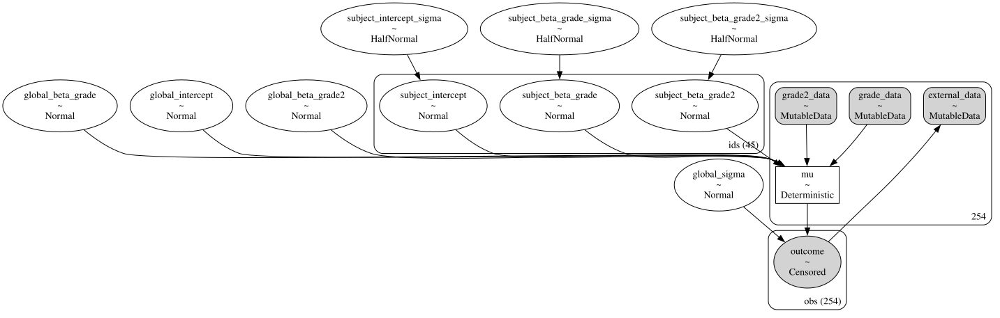

In [42]:
id_indx, unique_ids = pd.factorize(df_external["ID"])
coords = {"ids": unique_ids, "obs": range(len(df_external["EXTERNAL"]))}
with pm.Model(coords=coords) as model:
    grade = pm.MutableData("grade_data", df_external["GRADE"].values)
    grade2 = pm.MutableData("grade2_data", df_external["GRADE"].values ** 2)
    external = pm.MutableData("external_data", df_external["EXTERNAL"].values + 1e-25)

    global_intercept = pm.Normal("global_intercept", 6, 2)
    global_sigma = pm.Normal("global_sigma", 7, 1)
    global_beta_grade = pm.Normal("global_beta_grade", 0, 1)
    global_beta_grade2 = pm.Normal("global_beta_grade2", 0, 1)

    subject_intercept_sigma = pm.HalfNormal("subject_intercept_sigma", 1)
    subject_intercept = pm.Normal("subject_intercept", 2, subject_intercept_sigma, dims="ids")

    subject_beta_grade_sigma = pm.HalfNormal("subject_beta_grade_sigma", 1)
    subject_beta_grade = pm.Normal("subject_beta_grade", 0, subject_beta_grade_sigma, dims="ids")

    subject_beta_grade2_sigma = pm.HalfNormal("subject_beta_grade2_sigma", 1)
    subject_beta_grade2 = pm.Normal("subject_beta_grade2", 0, subject_beta_grade2_sigma, dims="ids")

    mu = pm.Deterministic(
        "mu",
        global_intercept
        + subject_intercept[id_indx]
        + (global_beta_grade + subject_beta_grade[id_indx]) * grade
        + (global_beta_grade2 + subject_beta_grade2[id_indx]) * grade2,
    )
    outcome_latent = pm.Gumbel.dist(mu, global_sigma)
    outcome = pm.Censored(
        "outcome", outcome_latent, lower=0, upper=68, observed=external, dims="obs"
    )
    idata_m6 = pm.sample_prior_predictive()
    idata_m6.extend(
        pm.sample(random_seed=100, target_accept=0.95, idata_kwargs={"log_likelihood": True})
    )
    idata_m6.extend(pm.sample_posterior_predictive(idata_m6))

pm.model_to_graphviz(model)

In [43]:
az.summary(
    idata_m6,
    var_names=[
        "global_intercept",
        "global_sigma",
        "global_beta_grade",
        "global_beta_grade2",
        "subject_intercept_sigma",
        "subject_beta_grade_sigma",
        "subject_beta_grade2_sigma",
    ],
)

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
global_intercept,6.496,1.157,4.394,8.734,0.019,0.014,3541.0,2895.0,1.00
global_sigma,7.013,0.388,6.301,7.756,0.007,0.005,2882.0,2847.0,1.00
global_beta_grade,-0.166,0.709,-1.440,1.211,0.012,0.012,3501.0,2636.0,1.00
global_beta_grade2,0.059,0.111,-0.144,0.270,0.002,0.002,3557.0,2499.0,1.00
subject_intercept_sigma,1.547,0.921,0.163,3.256,0.102,0.073,73.0,158.0,1.05
subject_beta_grade_sigma,1.310,0.278,0.768,1.838,0.015,0.011,361.0,465.0,1.02
subject_beta_grade2_sigma,0.096,0.064,0.008,0.214,0.011,0.008,33.0,125.0,1.10


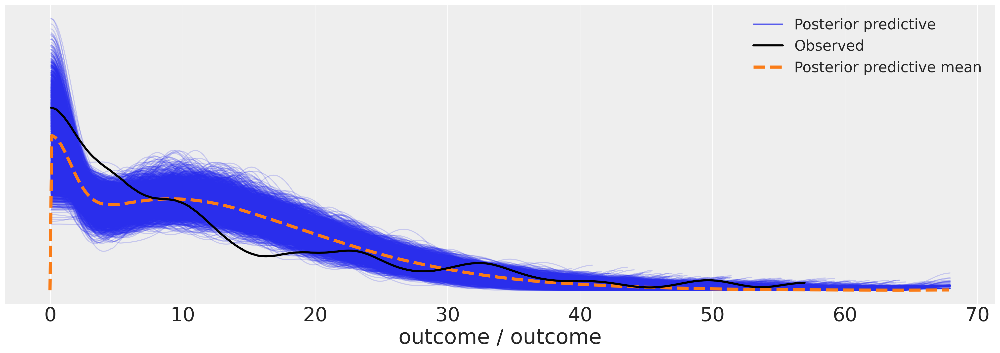

In [44]:
az.plot_ppc(idata_m6, figsize=(20, 7));

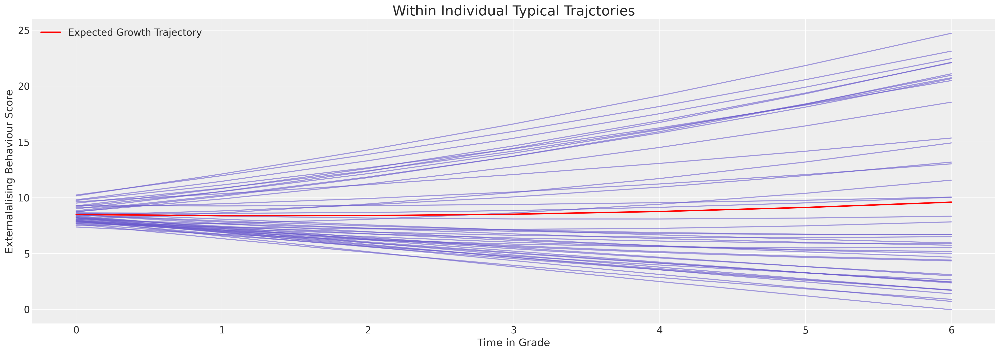

In [45]:
fig, ax = plt.subplots(figsize=(20, 7))
posterior = az.extract(idata_m6.posterior)
intercept_group_specific = posterior["subject_intercept"].mean("sample")
slope_group_specific = posterior["subject_beta_grade"].mean("sample")
slope_group_specific_2 = posterior["subject_beta_grade2"].mean("sample")
a = posterior["global_intercept"].mean() + intercept_group_specific
b = posterior["global_beta_grade"].mean() + slope_group_specific
c = posterior["global_beta_grade2"].mean() + slope_group_specific_2

time_xi = xr.DataArray(np.arange(7))
ax.plot(time_xi, (a + b * time_xi + c * (time_xi**2)).T, color="slateblue", alpha=0.6)
ax.plot(
    time_xi,
    (a.mean() + b.mean() * time_xi + c.mean() * (time_xi**2)),
    color="red",
    lw=2,
    label="Expected Growth Trajectory",
)
ax.set_ylabel("Externalalising Behaviour Score")
ax.set_xlabel("Time in Grade")
ax.legend()
ax.set_title("Within Individual Typical Trajctories", fontsize=20);

Granting the model more flexibility allows it to ascribe more nuanced growth trajectories.

## Comparing Trajectories across Gender

We'll now allow the model greater flexibility and pull in the gender of the subject to analyse whether and to what degree the gender of the teenager influences their behaviorial changes. 

In [46]:
id_indx, unique_ids = pd.factorize(df_external["ID"])
coords = {"ids": unique_ids, "obs": range(len(df_external["EXTERNAL"]))}
with pm.Model(coords=coords) as model:
    grade = pm.MutableData("grade_data", df_external["GRADE"].values)
    grade2 = pm.MutableData("grade2_data", df_external["GRADE"].values ** 2)
    grade3 = pm.MutableData("grade3_data", df_external["GRADE"].values ** 3)
    external = pm.MutableData("external_data", df_external["EXTERNAL"].values + 1e-25)
    female = pm.MutableData("female_data", df_external["FEMALE"].values)

    global_intercept = pm.Normal("global_intercept", 6, 2)
    global_sigma = pm.Normal("global_sigma", 7, 1)
    global_beta_grade = pm.Normal("global_beta_grade", 0, 1)
    global_beta_grade2 = pm.Normal("global_beta_grade2", 0, 1)
    global_beta_grade3 = pm.Normal("global_beta_grade3", 0, 1)
    global_beta_female = pm.Normal("global_beta_female", 0, 1)
    global_beta_female_grade = pm.Normal("global_beta_female_grade", 0, 1)
    global_beta_female_grade2 = pm.Normal("global_beta_female_grade2", 0, 1)
    global_beta_female_grade3 = pm.Normal("global_beta_female_grade3", 0, 1)

    subject_intercept_sigma = pm.Exponential("subject_intercept_sigma", 1)
    subject_intercept = pm.Normal("subject_intercept", 3, subject_intercept_sigma, dims="ids")

    subject_beta_grade_sigma = pm.Exponential("subject_beta_grade_sigma", 1)
    subject_beta_grade = pm.Normal("subject_beta_grade", 0, subject_beta_grade_sigma, dims="ids")

    subject_beta_grade2_sigma = pm.Exponential("subject_beta_grade2_sigma", 1)
    subject_beta_grade2 = pm.Normal("subject_beta_grade2", 0, subject_beta_grade2_sigma, dims="ids")

    subject_beta_grade3_sigma = pm.Exponential("subject_beta_grade3_sigma", 1)
    subject_beta_grade3 = pm.Normal("subject_beta_grade3", 0, subject_beta_grade3_sigma, dims="ids")

    mu = pm.Deterministic(
        "growth_model",
        global_intercept
        + subject_intercept[id_indx]
        + global_beta_female * female
        + global_beta_female_grade * (female * grade)
        + global_beta_female_grade2 * (female * grade2)
        + global_beta_female_grade3 * (female * grade3)
        + (global_beta_grade + subject_beta_grade[id_indx]) * grade
        + (global_beta_grade2 + subject_beta_grade2[id_indx]) * grade2
        + (global_beta_grade3 + subject_beta_grade3[id_indx]) * grade3,
    )

    outcome_latent = pm.Gumbel.dist(mu, global_sigma)
    outcome = pm.Censored(
        "outcome", outcome_latent, lower=0, upper=68, observed=external, dims="obs"
    )

    idata_m7 = pm.sample_prior_predictive()
    idata_m7.extend(
        sample_numpyro_nuts(
            draws=5000, random_seed=100, target_accept=0.99, idata_kwargs={"log_likelihood": True}
        )
    )
    idata_m7.extend(pm.sample_posterior_predictive(idata_m7))

Sampling: [global_beta_female, global_beta_female_grade, global_beta_female_grade2, global_beta_female_grade3, global_beta_grade, global_beta_grade2, global_beta_grade3, global_intercept, global_sigma, outcome, subject_beta_grade, subject_beta_grade2, subject_beta_grade2_sigma, subject_beta_grade3, subject_beta_grade3_sigma, subject_beta_grade_sigma, subject_intercept, subject_intercept_sigma]


Compiling...
Compilation time =  0:00:02.280265
Sampling...


  0%|          | 0/6000 [00:00<?, ?it/s]

  0%|          | 0/6000 [00:00<?, ?it/s]

  0%|          | 0/6000 [00:00<?, ?it/s]

  0%|          | 0/6000 [00:00<?, ?it/s]

Sampling time =  0:01:20.116929
Transforming variables...
Transformation time =  0:00:00.610429
Computing Log Likelihood...


Sampling: [outcome]


Log Likelihood time =  0:00:00.564376


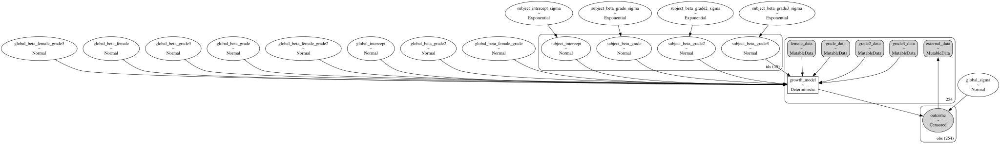

In [47]:
pm.model_to_graphviz(model)

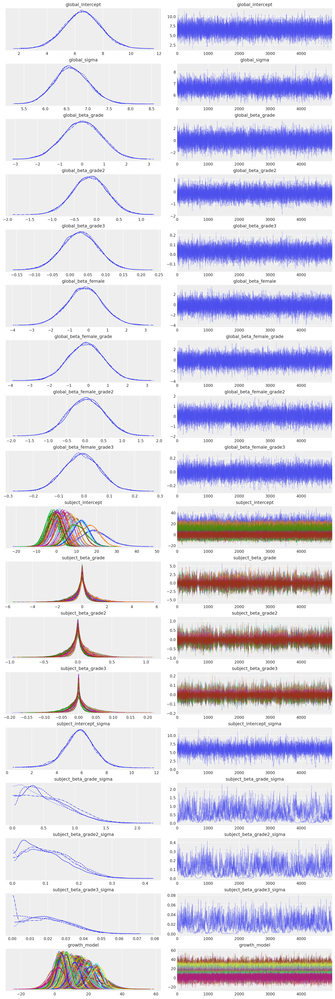

In [48]:
az.plot_trace(idata_m7);

In [49]:
az.summary(
    idata_m7,
    var_names=[
        "global_intercept",
        "global_sigma",
        "global_beta_grade",
        "global_beta_grade2",
        "subject_intercept_sigma",
        "subject_beta_grade_sigma",
        "subject_beta_grade2_sigma",
        "subject_beta_grade3_sigma",
        "global_beta_female",
        "global_beta_female_grade",
        "global_beta_female_grade2",
        "global_beta_female_grade3",
    ],
)

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
global_intercept,6.562,1.298,4.062,8.954,0.010,0.007,17706.0,15699.0,1.00
global_sigma,6.616,0.407,5.834,7.363,0.006,0.004,4818.0,11058.0,1.00
global_beta_grade,0.011,0.874,-1.663,1.591,0.006,0.006,19302.0,15874.0,1.00
global_beta_grade2,-0.149,0.387,-0.889,0.564,0.003,0.003,14814.0,13206.0,1.00
subject_intercept_sigma,5.782,1.251,3.361,8.147,0.031,0.022,1762.0,1889.0,1.00
subject_beta_grade_sigma,0.547,0.364,0.006,1.190,0.020,0.014,228.0,219.0,1.02
subject_beta_grade2_sigma,0.109,0.069,0.001,0.226,0.004,0.003,183.0,134.0,1.02
subject_beta_grade3_sigma,0.020,0.013,0.000,0.042,0.001,0.001,161.0,42.0,1.03
global_beta_female,-0.210,0.941,-2.012,1.561,0.006,0.007,28565.0,15427.0,1.00
global_beta_female_grade,-0.133,0.896,-1.850,1.498,0.006,0.006,21601.0,15941.0,1.00


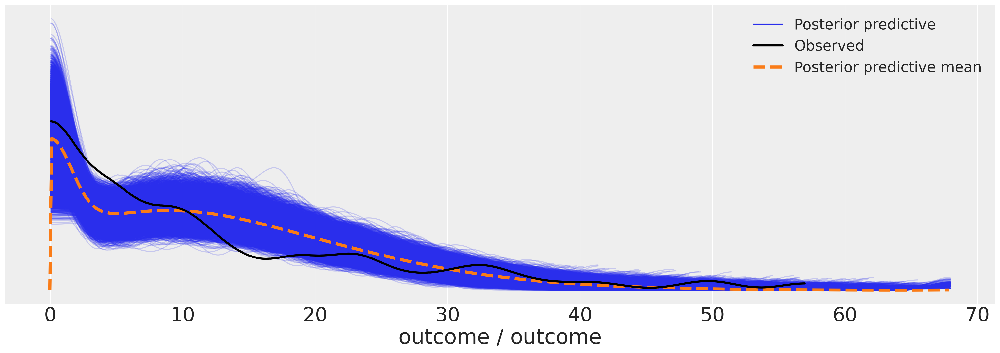

In [50]:
az.plot_ppc(idata_m7, figsize=(20, 7));

## Comparing Models

As above we'll compare the various models for parameter fits and model performance measures using WAIC. 

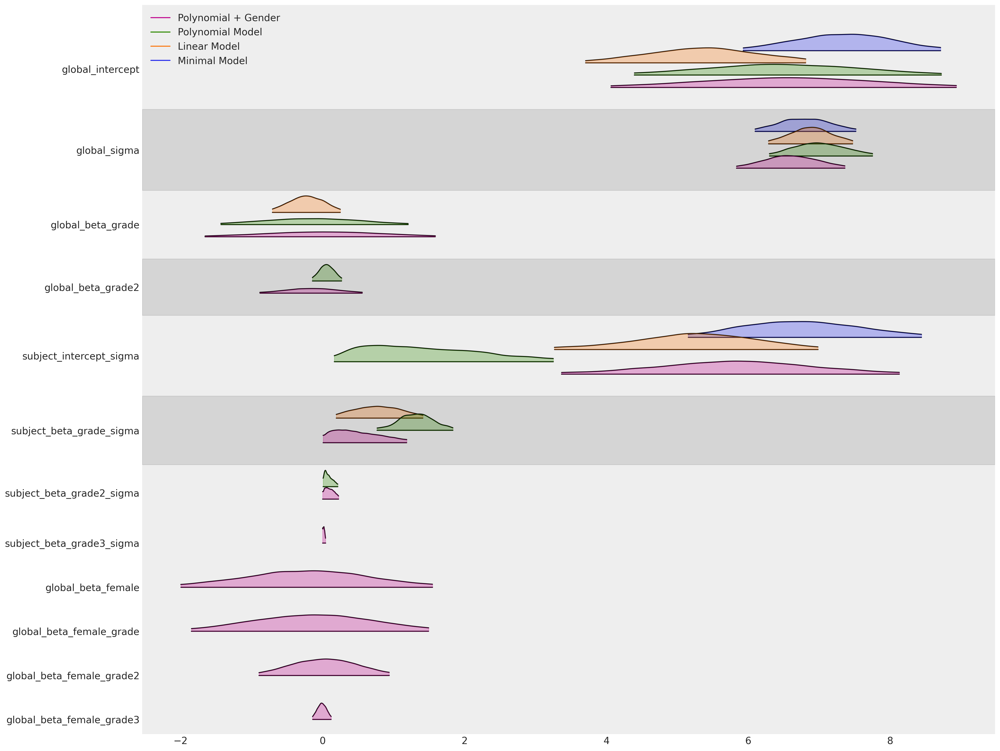

In [51]:
az.plot_forest(
    [idata_m4, idata_m5, idata_m6, idata_m7],
    model_names=["Minimal Model", "Linear Model", "Polynomial Model", "Polynomial + Gender"],
    var_names=[
        "global_intercept",
        "global_sigma",
        "global_beta_grade",
        "global_beta_grade2",
        "subject_intercept_sigma",
        "subject_beta_grade_sigma",
        "subject_beta_grade2_sigma",
        "subject_beta_grade3_sigma",
        "global_beta_female",
        "global_beta_female_grade",
        "global_beta_female_grade2",
        "global_beta_female_grade3",
    ],
    figsize=(20, 15),
    kind="ridgeplot",
    combined=True,
    coords={"ids": [1, 2, 30]},
    ridgeplot_alpha=0.3,
);

In [52]:
compare = az.compare(
    {
        "Minimal Model": idata_m4,
        "Linear Model": idata_m5,
        "Polynomial Model": idata_m6,
        "Polynomial + Gender": idata_m7,
    },
    "waic",
)
compare

/Users/nathanielforde/mambaforge/envs/pymc_examples_new/lib/python3.9/site-packages/arviz/stats/stats.py:1645: UserWarning: For one or more samples the posterior variance of the log predictive densities exceeds 0.4. This could be indication of WAIC starting to fail. 
See http://arxiv.org/abs/1507.04544 for details
  warnings.warn(
/Users/nathanielforde/mambaforge/envs/pymc_examples_new/lib/python3.9/site-packages/arviz/stats/stats.py:1645: UserWarning: For one or more samples the posterior variance of the log predictive densities exceeds 0.4. This could be indication of WAIC starting to fail. 
See http://arxiv.org/abs/1507.04544 for details
  warnings.warn(
/Users/nathanielforde/mambaforge/envs/pymc_examples_new/lib/python3.9/site-packages/arviz/stats/stats.py:1645: UserWarning: For one or more samples the posterior variance of the log predictive densities exceeds 0.4. This could be indication of WAIC starting to fail. 
See http://arxiv.org/abs/1507.04544 for details
  warnings.warn(
/

,rank,elpd_waic,p_waic,elpd_diff,weight,se,dse,warning,scale
Polynomial + Gender,0,-909.783142,43.724719,0.000000,1.000000e+00,13.171545,0.000000,True,log
Linear Model,1,-912.673495,32.490124,2.890353,0.000000e+00,13.151568,1.744297,True,log
Minimal Model,2,-913.991390,30.208442,4.208248,0.000000e+00,13.540810,2.680947,True,log
Polynomial Model,3,-921.420283,27.611347,11.637140,5.773160e-14,14.567538,4.005786,True,log


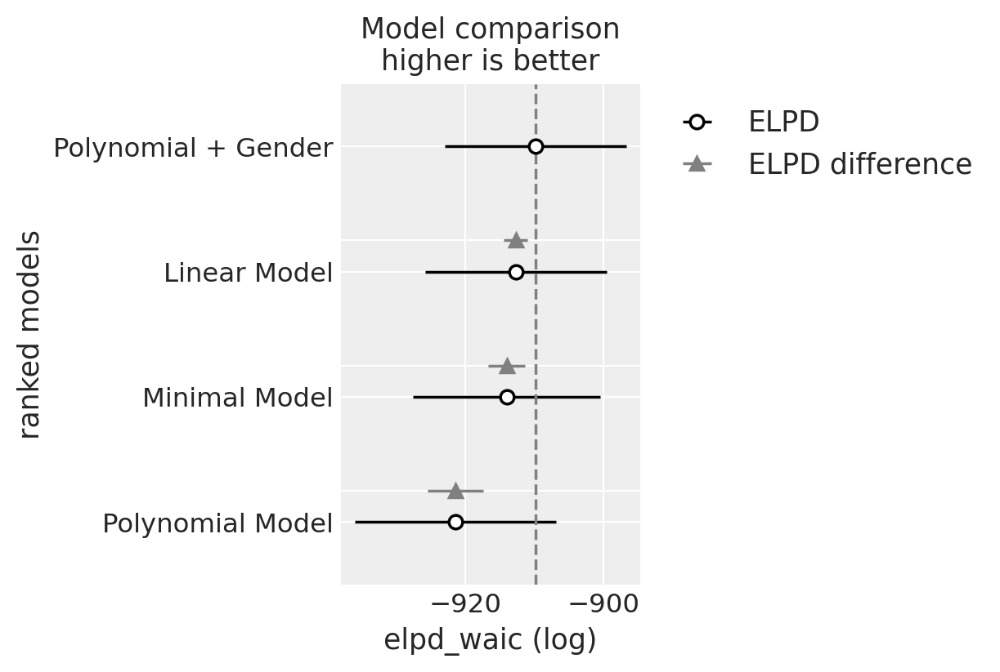

In [53]:
az.plot_compare(compare);

As perhaps expected our final gender based model is deemed to be best according the WAIC ranking. But somewhat suprisingly the Linear model with fixed trajectories is not far behind. 

## Plotting the Final Model

We want to show the model fits for a number of individuals and the more generally implied trajectory across the population. 

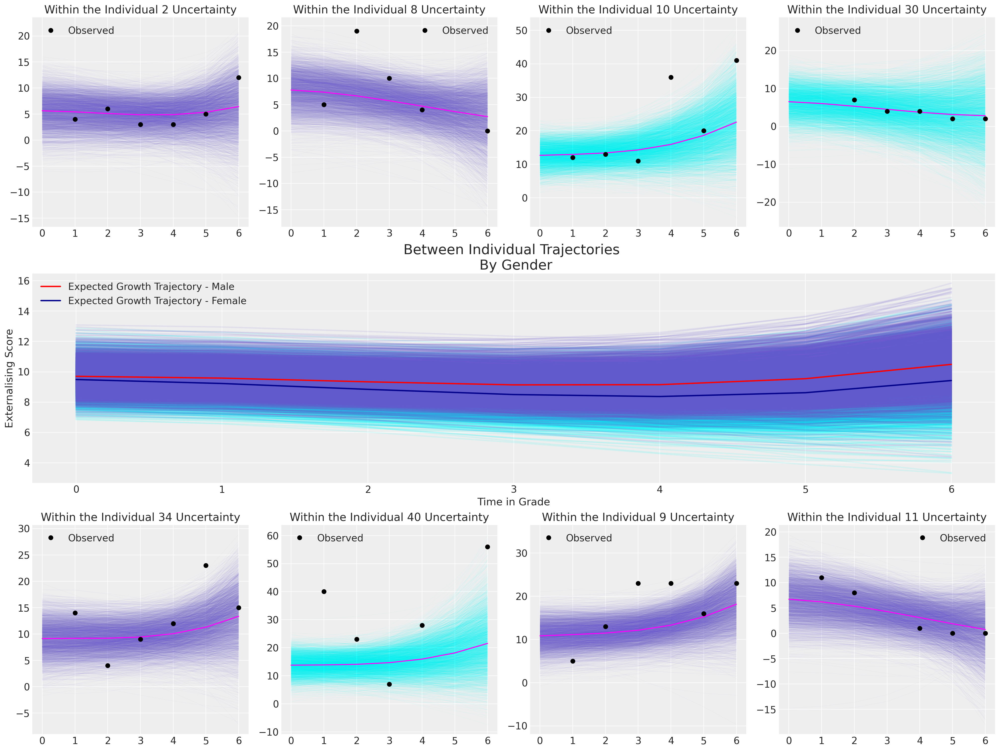

In [54]:
def plot_individual(posterior, individual, female, ax):
    posterior = posterior.sel(ids=individual)
    time_xi = xr.DataArray(np.arange(7))
    i = posterior["global_intercept"].mean() + posterior["subject_intercept"]
    a = (posterior["global_beta_grade"].mean() + posterior["subject_beta_grade"]) * time_xi
    b = (posterior["global_beta_grade2"].mean() + posterior["subject_beta_grade2"]) * time_xi**2
    c = (posterior["global_beta_grade3"].mean() + posterior["subject_beta_grade3"]) * time_xi**3
    d = posterior["global_beta_female"].mean() * female + posterior["global_beta_female_grade"] * (
        time_xi * female
    )
    fit = i + a + b + c + d
    if female:
        color = "cyan"
    else:
        color = "slateblue"
    for i in range(len(fit)):
        ax.plot(time_xi, fit[i], color=color, alpha=0.1, linewidth=0.2)
    ax.plot(time_xi, fit.mean(axis=0), color="magenta")


mosaic = """BCDE
            AAAA
            FGHI"""
fig, axs = plt.subplot_mosaic(mosaic=mosaic, figsize=(20, 15))
axs = [axs[k] for k in axs.keys()]
posterior = az.extract(idata_m7.posterior, num_samples=4000)
intercept_group_specific = posterior["subject_intercept"].mean("ids")
slope_group_specific = posterior["subject_beta_grade"].mean("ids")
slope_group_specific_2 = posterior["subject_beta_grade2"].mean("ids")
slope_group_specific_3 = posterior["subject_beta_grade3"].mean("ids")
a = posterior["global_intercept"].mean() + intercept_group_specific
b = posterior["global_beta_grade"].mean() + slope_group_specific
c = posterior["global_beta_grade2"].mean() + slope_group_specific_2
d = posterior["global_beta_grade3"].mean() + slope_group_specific_3
e = posterior["global_beta_female"].mean()
f = posterior["global_beta_female_grade"].mean()

time_xi = xr.DataArray(np.arange(7))

axs[4].plot(
    time_xi,
    (a + b * time_xi + c * (time_xi**2) + d * (time_xi**3) + e * 1 + f * (1 * time_xi)).T,
    color="cyan",
    linewidth=2,
    alpha=0.1,
)
axs[4].plot(
    time_xi,
    (a + b * time_xi + c * (time_xi**2) + d * (time_xi**3) + e * 0 + f * (0 * time_xi)).T,
    color="slateblue",
    alpha=0.1,
    linewidth=2,
)
axs[4].plot(
    time_xi,
    (
        a.mean()
        + b.mean() * time_xi
        + c.mean() * (time_xi**2)
        + d.mean() * (time_xi**3)
        + e * 0
        + f * (0 * time_xi)
    ),
    color="red",
    lw=2,
    label="Expected Growth Trajectory - Male",
)

axs[4].plot(
    time_xi,
    (
        a.mean()
        + b.mean() * time_xi
        + c.mean() * (time_xi**2)
        + d.mean() * (time_xi**3)
        + e * 1
        + f * (1 * time_xi)
    ),
    color="darkblue",
    lw=2,
    label="Expected Growth Trajectory - Female",
)

for indx, id in zip([0, 1, 2, 3, 5, 6, 7, 8], [2, 8, 10, 30, 34, 40, 9, 11]):
    female = df_external[df_external["ID"] == id]["FEMALE"].unique()[0] == 1
    plot_individual(posterior, id, female, axs[indx])
    axs[indx].plot(
        df_external[df_external["ID"] == id]["GRADE"],
        df_external[df_external["ID"] == id]["EXTERNAL"],
        "o",
        color="black",
        label="Observed",
    )
    axs[indx].set_title(f"Within the Individual {id} Uncertainty")
    axs[indx].legend()


axs[4].set_ylabel("Externalising Score")
axs[4].set_xlabel("Time in Grade")
axs[4].legend()
axs[4].set_title("Between Individual Trajectories \n By Gender", fontsize=20);

The implications of this final model suggest that there is a very slight differences in the probable growth trajectories between men and women, and moreover that the change in level of externalising behaviours over time is quite minimal, but tends to tick upwards by grade 6. Notice how for Individual 40, the model implied fits cannot capture the wild swings in the observed data. This is due to the shrinkage effect which strongly pulls our our intercept term towards the global mean. This is a good reminder that the model is aid to generalisation, not a perfect representation of individual trajectories.  

# Conclusion

We've now seen how the Bayesian hierarchical models can be adapted to study and interrogate questions about change over time. We seen how the flexible nature of the Bayesian workflow can incorporate different combinations of priors and model specifications to capture subtle aspects of the data generating process. Crucially, we've seen how to move between the within individual view  and the between individual implications of our model fits, while assessing the models for their fidelity to the data. There are subtle issues around how to assess causal inference questions in the panel data context, but it is also clear that longitudinal modeling allows us to sift through the complexities of individual difference in a systematic and principled fashion. 

These are powerful models for capturing and assessing patterns of change to compare within and across cohorts. Without random controlled trials or other designed experiments and quasi-experimental patterns, panel data analysis of this kind is as close as you're going to get to deriving a causal conclusion from observational data that accounts (at least partially) for heterogeneity in the treatment outcomes of individuals. 



## Authors
- Authored by [Nathaniel Forde](https://nathanielf.github.io/) in April 2023 

## References
:::{bibliography}
:filter: docname in docnames
:::


## Watermark

In [55]:
%load_ext watermark
%watermark -n -u -v -iv -w -p pytensor

Last updated: Mon Apr 10 2023

Python implementation: CPython
Python version       : 3.9.16
IPython version      : 8.11.0

pytensor: 2.8.11

bambi      : 0.10.0
xarray     : 2023.2.0
pandas     : 1.5.3
numpy      : 1.23.5
statsmodels: 0.13.5
pymc       : 5.0.1
matplotlib : 3.7.1
arviz      : 0.15.1

Watermark: 2.3.1



:::{include} ../page_footer.md
:::